# Women's imprisonment rates
## Local factsheet: Visualisations

We have three separate visualisations to create here:
* Line chart — Use of immediate imprisonment for women, 2009-2021 
* Pie chart (or equivalent) — Imprisonment of women by offence group, 2021
* Grouped bar chart — Sentencing of women to Community Orders, Suspended Sentences and Immediate Imprisonment, 2009-2021

## Importing libraries

In [3]:
import pandas as pd
import textwrap
import plotly.graph_objs as go
import plotly.io as pio
from pathlib import Path #To create unique filenames for each PFA chart

### Setting template

In [4]:
pio.templates
prt_template = go.layout.Template(
    layout=go.Layout(
        title_font=dict(family="Helvetica Neue, Arial", size=17),
        font_color="#54565B",
        font_family="Helvetica Neue, Arial",
        font_size=12,
        paper_bgcolor="#FBFAF7",
        plot_bgcolor="#FBFAF7",
        colorway=("#A01D28", "#499CC9", "#F9A237", "#6FBA3A", "#573D6B"),
    )
)

config = dict(
    {
        "scrollZoom": False,
        "displayModeBar": False,
        "editable": False,
        "displaylogo": False,
        "showAxisDragHandles": False,
    }
)

## Chart 1: Use of immediate imprisonment for women, 2009–21

#### Reading in data

In [1]:
df = pd.read_csv('../data/interim/PFA_2009-21_women_cust_sentence_len.csv')

In [2]:
df.head()

,pfa,year,sentence_len,freq
0,Avon and Somerset,2009,12 months or more,37
1,Avon and Somerset,2009,6 months and under 12 months,11
2,Avon and Somerset,2009,Less than 6 months,117
3,Avon and Somerset,2010,12 months or more,44
4,Avon and Somerset,2010,6 months and under 12 months,16


#### Replacing 6 months and under 12 months to something more chart friendly

In [3]:
df['sentence_len'] = df['sentence_len'].str.replace("6 months and under 12 months", "6 months–<br>under 12 months")

In [4]:
filt = df['pfa'] == "Avon and Somerset"
df_filt = df[filt]
df_filt

,pfa,year,sentence_len,freq
0,Avon and Somerset,2009,12 months or more,37
1,Avon and Somerset,2009,6 months–<br>under 12 months,11
2,Avon and Somerset,2009,Less than 6 months,117
3,Avon and Somerset,2010,12 months or more,44
4,Avon and Somerset,2010,6 months–<br>under 12 months,16
5,Avon and Somerset,2010,Less than 6 months,113
6,Avon and Somerset,2011,12 months or more,43
7,Avon and Somerset,2011,6 months–<br>under 12 months,21
8,Avon and Somerset,2011,Less than 6 months,142
9,Avon and Somerset,2012,12 months or more,38


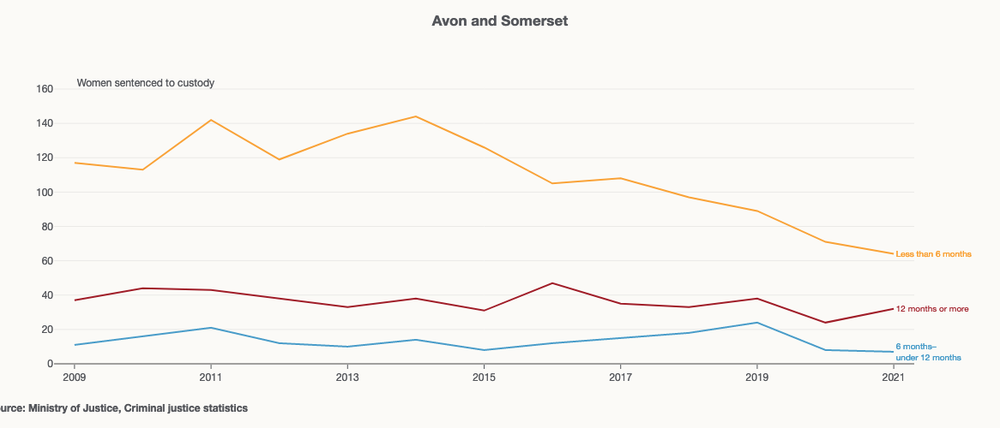

In [7]:
fig = go.Figure()

trace_list = []
for i in df_filt[
    "sentence_len"
].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
    df2 = df_filt[df_filt["sentence_len"] == i]

    trace = go.Scatter(
        x=df2["year"],
        y=df2["freq"],
        mode="lines",
        name=str(df2["sentence_len"].iloc[0]),
        hovertemplate="%{y}<extra></extra>",
    )

    trace_list.append(trace)

fig.add_traces(trace_list)

## Chart title
title = textwrap.wrap(f"<b>{df2['pfa'].iloc[0]}</b>", width=100)

fig.update_layout(
    margin=dict(l=63, b=75, r=100),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    yaxis_title="",
    yaxis_tickformat=",.0f",
    yaxis_tick0=0,
    xaxis_dtick=2,
    xaxis_tick0=2009,    
    xaxis_showgrid=False,
    xaxis_tickcolor="#54565B",
    template=prt_template,
    showlegend=False,
    hovermode="x",
    modebar_activecolor="#A01D28",
    width=655,
    height=500,
)

## Chart annotations
annotations = []

# Adding trace annotations
for i in range(0, len(fig.data)):
    annotations.append(
        dict(
            xref="x",
            yref="y",
            x=fig.data[i].x[-1],
            y=fig.data[i].y[-1],
            text=str(fig.data[i].name),
            xanchor="left",
            align="left",
            showarrow=False,
            font_color=prt_template.layout.colorway[i],
            font_size=10,
        )
    )

# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=-0.08,
        y=-0.19,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)

# Adding y-axis label
annotations.append(
    dict(
        xref="x",
        yref="paper",
        x=df['year'].iloc[0],
        y=1.04,
        align="left",
        xanchor="left",
        showarrow=False,
        text="Women sentenced to custody",
        font_size=12,
    )
)

# Adding annotations to layout
fig.update_layout(annotations=annotations)


## Setting chart axis ranges
fig.update_yaxes(range=[0, 162])
fig.update_xaxes(range=[2008.7, 2021.3])

fig.show(config=config)

## Exporting to static image

# Save results to ../reports/figures/custody_sentence_lengths, generate if does not exist.
export_path = Path.joinpath(Path.cwd().parent, "reports", "figures", "custody_sentence_lengths")
export_path.mkdir(parents=True, exist_ok=True)

# Setting filename variable and full path

filename = str(df2["pfa"].iloc[0])
export_svg_path = Path.joinpath(export_path, f'{filename}' + '.svg')

# fig.write_image(export_svg_path)

#### Concept seems to work, so let's test this out with a small loop of PFAs

In [7]:
filt = df['pfa'].isin(["Avon and Somerset", "Derbyshire", "Wiltshire"])
df_filt = df[filt]
df_filt

,pfa,year,sentence_len,freq
0,Avon and Somerset,2009,12 months or more,37
1,Avon and Somerset,2009,6 months–<br>under 12 months,11
2,Avon and Somerset,2009,Less than 6 months,117
3,Avon and Somerset,2010,12 months or more,44
4,Avon and Somerset,2010,6 months–<br>under 12 months,16
...,...,...,...,...
1626,Wiltshire,2020,6 months–<br>under 12 months,6
1627,Wiltshire,2020,Less than 6 months,15
1628,Wiltshire,2021,12 months or more,15
1629,Wiltshire,2021,6 months–<br>under 12 months,3


In [8]:
df_filt['pfa'].unique()

array(['Avon and Somerset', 'Derbyshire', 'Wiltshire'], dtype=object)

Building my loop

In [10]:
for pfa in df_filt['pfa'].unique():
    pfa_df = df_filt[df_filt["pfa"] == pfa]
    trace_list = [] # Need to empty my trace_list with every loop through each PFA so that charts are plotted separately

    for i in pfa_df["sentence_len"].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
        pfa_df_sentence = pfa_df[pfa_df["sentence_len"] == i]
        
        trace = go.Scatter(
            x=pfa_df_sentence["year"],
            y=pfa_df_sentence["freq"],
            mode="lines",
            name=str(pfa_df_sentence["sentence_len"].iloc[0]),
            meta=pfa_df_sentence["pfa"].iloc[0],   # Adding name of PFA in metadata to ensure data relates to only one area 
            hovertemplate="%{y}<extra></extra>"
        )

        trace_list.append(trace)

    print(trace_list)

[Scatter({
    'hovertemplate': '%{y}<extra></extra>',
    'meta': 'Avon and Somerset',
    'mode': 'lines',
    'name': '12 months or more',
    'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                2021]),
    'y': array([37, 44, 43, 38, 33, 38, 31, 47, 35, 33, 38, 24, 32])
}), Scatter({
    'hovertemplate': '%{y}<extra></extra>',
    'meta': 'Avon and Somerset',
    'mode': 'lines',
    'name': '6 months–<br>under 12 months',
    'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                2021]),
    'y': array([11, 16, 21, 12, 10, 14,  8, 12, 15, 18, 24,  8,  7])
}), Scatter({
    'hovertemplate': '%{y}<extra></extra>',
    'meta': 'Avon and Somerset',
    'mode': 'lines',
    'name': 'Less than 6 months',
    'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                2021]),
    'y': array([117, 113, 142, 119, 134, 144, 126, 105, 108,  97,  89,  71,  64])


In [11]:
trace_list

[Scatter({
     'hovertemplate': '%{y}<extra></extra>',
     'meta': 'Wiltshire',
     'mode': 'lines',
     'name': '12 months or more',
     'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                 2021]),
     'y': array([13, 13, 13, 10,  9,  9, 13, 11, 13,  6, 13, 13, 15])
 }),
 Scatter({
     'hovertemplate': '%{y}<extra></extra>',
     'meta': 'Wiltshire',
     'mode': 'lines',
     'name': '6 months–<br>under 12 months',
     'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                 2021]),
     'y': array([7, 3, 3, 2, 1, 4, 7, 7, 2, 5, 4, 6, 3])
 }),
 Scatter({
     'hovertemplate': '%{y}<extra></extra>',
     'meta': 'Wiltshire',
     'mode': 'lines',
     'name': 'Less than 6 months',
     'x': array([2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
                 2021]),
     'y': array([ 6,  6, 15, 21, 14, 19, 24, 31, 32, 38, 32, 15, 15])
 })]

### Testing some logic to stop trace labels from overlapping

Accessing the y values of the annotations

In [16]:
for i in range(len(annotations)):
    print(annotations[i]["y"])

15
3
15


Checking max value for a trace

In [18]:
for i in range(len(fig.data)):
    print((fig.data[i].y).max())

15
7
38


Now trying to combine the two together

Steps:
* Check whether there are any duplicate y values in the annotation.
* If not then proceed as usual
* If there are then examine which of the two traces has the highest maximum value and apply a factor.

This works for the first part

In [25]:
y_list = []
trace_max = []

def find_dups(list_to_check, item_to_find):
    for i in range(len(fig.data)):    
        j = annotations[i]["y"]
        y_list.append(j)
        trace_max.append((fig.data[i].y).max())

    #If j is equal to any other value in the list see which has the greater
    return [idx for idx, value in enumerate(y_list) if value == j]
     
find_dups(y_list, j)
    

[0, 2]

Continuing onto the final stage

In [58]:
y_list = []
trace_max = []

def find_dups(list_to_check, item_to_find):
    for i in range(len(fig.data)):    
        j = annotations[i]["y"]
        y_list.append(j)
        trace_max.append((fig.data[i].y).max())

    dups = [idx for idx, value in enumerate(y_list) if value == j]
    maxi = 0

    for i in dups:
        if trace_max[i] > maxi:
            maxi = i

    # y_list[maxi] = y_list[maxi] * 1.5
    annotations[maxi]["y"] = y_list[maxi] * 1.5
    
    return annotations
    

    
find_dups(y_list, j)
    

[{'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 15,
  'text': '12 months or more',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#A01D28',
  'font_size': 10},
 {'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 3,
  'text': '6 months–<br>under 12 months',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#499CC9',
  'font_size': 10},
 {'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 50.625,
  'text': 'Less than 6 months',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#F9A237',
  'font_size': 10},
 {'xref': 'paper',
  'yref': 'paper',
  'x': -0.08,
  'y': -0.19,
  'align': 'left',
  'showarrow': False,
  'text': '<b>Source: Ministry of Justice, Criminal justice statistics</b>',
  'font_size': 12},
 {'xref': 'x',
  'yref': 'paper',
  'x': 2009,
  'y': 1.04,
  'align': 'left',
  'xanchor': 'left',
  'showarrow': False,
  'text': 'Women sentenced to custody',
  'font_size': 12}]

In [58]:
y_list = []
trace_max = []

def find_dups(list_to_check, item_to_find):
    for i in range(len(fig.data)):    
        j = annotations[i]["y"]
        y_list.append(j)
        trace_max.append((fig.data[i].y).max())

    dups = [idx for idx, value in enumerate(y_list) if value == j]
    maxi = 0

    for i in dups:
        if trace_max[i] > maxi:
            maxi = i

    # y_list[maxi] = y_list[maxi] * 1.5
    annotations[maxi]["y"] = y_list[maxi] * 1.5
    
    return annotations
    

    
find_dups(y_list, j)
    

[{'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 15,
  'text': '12 months or more',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#A01D28',
  'font_size': 10},
 {'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 3,
  'text': '6 months–<br>under 12 months',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#499CC9',
  'font_size': 10},
 {'xref': 'x',
  'yref': 'y',
  'x': 2021,
  'y': 50.625,
  'text': 'Less than 6 months',
  'xanchor': 'left',
  'align': 'left',
  'showarrow': False,
  'font_color': '#F9A237',
  'font_size': 10},
 {'xref': 'paper',
  'yref': 'paper',
  'x': -0.08,
  'y': -0.19,
  'align': 'left',
  'showarrow': False,
  'text': '<b>Source: Ministry of Justice, Criminal justice statistics</b>',
  'font_size': 12},
 {'xref': 'x',
  'yref': 'paper',
  'x': 2009,
  'y': 1.04,
  'align': 'left',
  'xanchor': 'left',
  'showarrow': False,
  'text': 'Women sentenced to custody',
  'font_size': 12}]

In [59]:
type(annotations)

list

In [57]:
y_list

[15, 3, 22.5]

In [38]:
trace_max

[15, 7, 38]

In [48]:
dups = [0, 2]
maxi = 0

for i in dups:
    if trace_max[i] > maxi:
        maxi = i

y_list[maxi] = y_list[maxi] * 1.5
        
print(y_list[maxi])


22.5


In [ ]:
#https://datagy.io/python-list-find-all-index/

def find_indices(list_to_check, item_to_find):
    return [idx for idx, value in enumerate(list_to_check) if value == item_to_find]

print(find_indices(a_list, 1))

In [9]:
y_list.count(15)

NameError: name 'y_list' is not defined

In [12]:
y_list = []
for i in range(len(annotations)):    
    j = annotations[i]["y"]
    y_list.append(j)
y_list

[15, 3, 15, -0.19, 1.04]

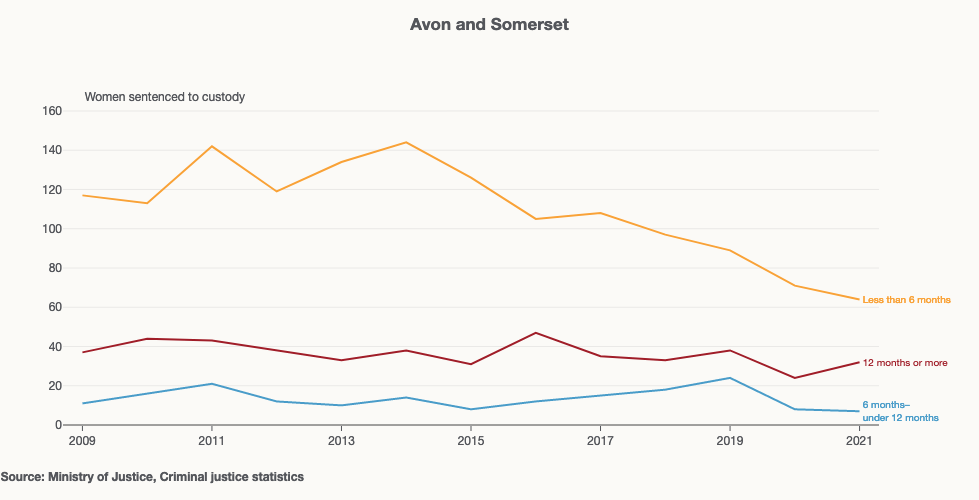

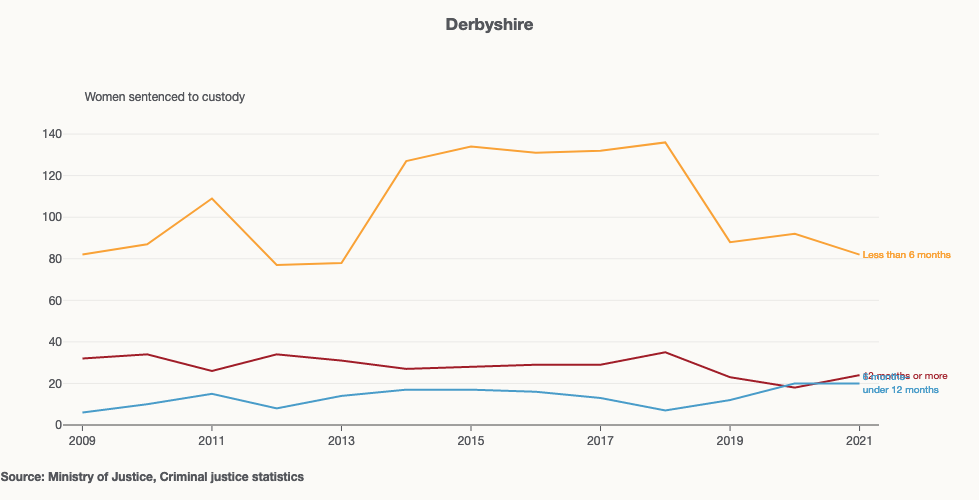

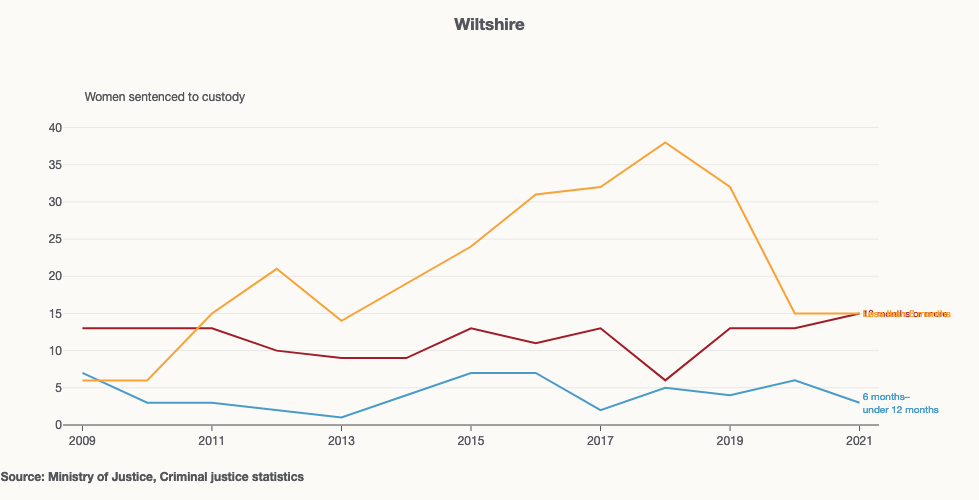

In [54]:
for pfa in df_filt['pfa'].unique():
    pfa_df = df_filt[df_filt["pfa"] == pfa]
    trace_list = [] # Need to empty my trace_list with every loop through each PFA so that charts are plotted separately
    fig = go.Figure() # Need to also instantiate the figure with every loop in order to clear fig.data values

    for i in pfa_df["sentence_len"].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
        pfa_df_sentence = pfa_df[pfa_df["sentence_len"] == i]
        
        trace = go.Scatter(
            x=pfa_df_sentence["year"],
            y=pfa_df_sentence["freq"],
            mode="lines",
            name=str(pfa_df_sentence["sentence_len"].iloc[0]),
            meta=pfa_df_sentence["pfa"].iloc[0],   # Adding name of PFA in metadata to ensure data relates to only one area 
            hovertemplate="%{y}<extra></extra>"
        )

        trace_list.append(trace)

    fig.add_traces(trace_list)

    ## Chart title
    title = textwrap.wrap(f'<b>{pfa_df_sentence["pfa"].iloc[0]}</b>', width=100)

    fig.update_layout(
        margin=dict(l=63, b=75, r=100),
        title="<br>".join(title),
        title_y=0.94,
        title_yanchor="bottom",
        yaxis_title="",
        yaxis_tickformat=",.0f",
        yaxis_tick0=0,
        yaxis_nticks=10,        
        xaxis_dtick=2,
        xaxis_tick0=2009,    
        xaxis_showgrid=False,
        xaxis_tickcolor="#54565B",
        template=prt_template,
        showlegend=False,
        hovermode="x",
        modebar_activecolor="#A01D28",
        width=655,
        height=500,
    )

    ## Chart annotations
    annotations = []

    # Adding trace annotations
    for j in range(0, len(trace_list)):
        annotations.append(
            dict(
                xref="x",
                yref="y",
                x=fig.data[j].x[-1],
                y=fig.data[j].y[-1],
                text=str(fig.data[j].name),
                xanchor="left",
                align="left",
                showarrow=False,
                font_color=prt_template.layout.colorway[j],
                font_size=10,
            )
        )

    # Adding source label
    annotations.append(
        dict(
            xref="paper",
            yref="paper",
            x=-0.08,
            y=-0.19,
            align="left",
            showarrow=False,
            text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
            font_size=12,
        )
    )

    # Adding y-axis label
    annotations.append(
        dict(
            xref="x",
            yref="paper",
            x=df['year'].iloc[0],
            y=1.04,
            align="left",
            xanchor="left",
            showarrow=False,
            text="Women sentenced to custody",
            font_size=12,
        )
    )

    # Adding annotations to layout
    fig.update_layout(annotations=annotations)


    ## Setting chart axis ranges
    for i in range(len(fig.data)):
        max_trace = (fig.data[i].y).max()
    
    fig.update_yaxes(range=[0, max_trace + (max_trace * 0.15)])
    fig.update_xaxes(range=[2008.7, 2021.3])

    fig.show(config=config)

    ## Exporting to static image

    # Save results to ../reports/figures/custody_sentence_lengths, generate if does not exist.
    export_path = Path.joinpath(Path.cwd().parent, "reports", "figures", "custody_sentence_lengths")
    export_path.mkdir(parents=True, exist_ok=True)

    # Setting filename variable and full path

    filename = str(pfa_df_sentence["pfa"].iloc[0])
    export_svg_path = Path.joinpath(export_path, f'{filename}' + '.svg')

    # fig.write_image(export_svg_path)

### Obviously need to tidy up some of the formatting challenges with overlayed annotations, but the concept seems to work, let's try a larger loop.

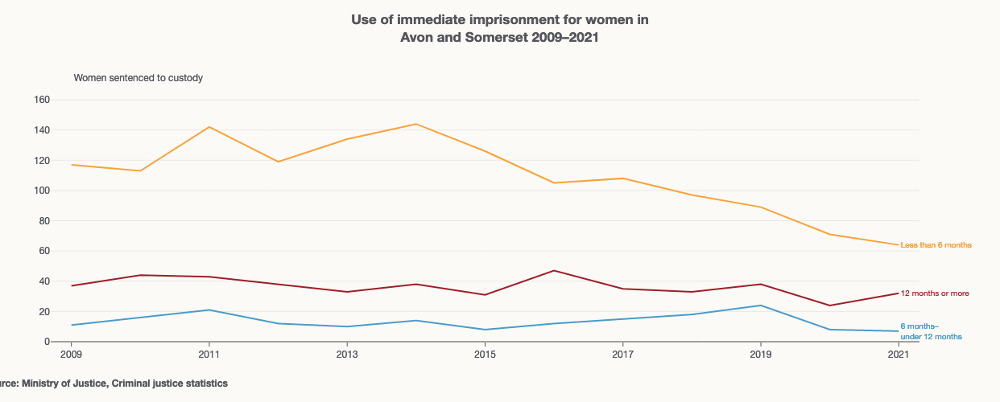

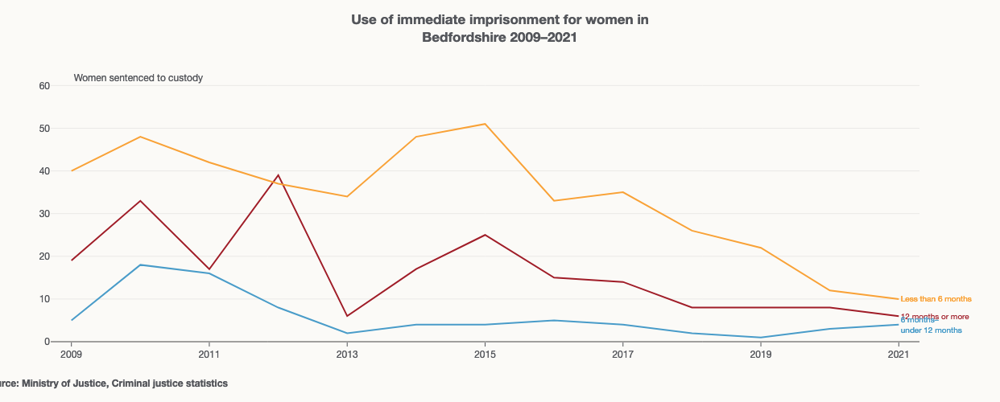

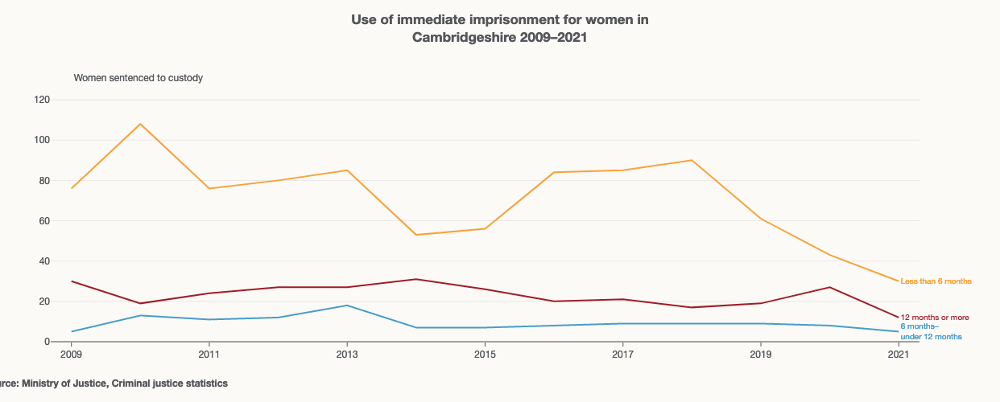

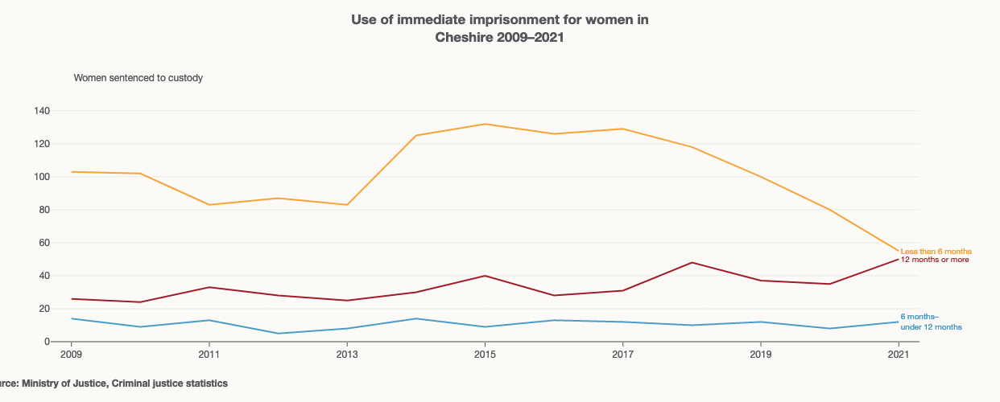

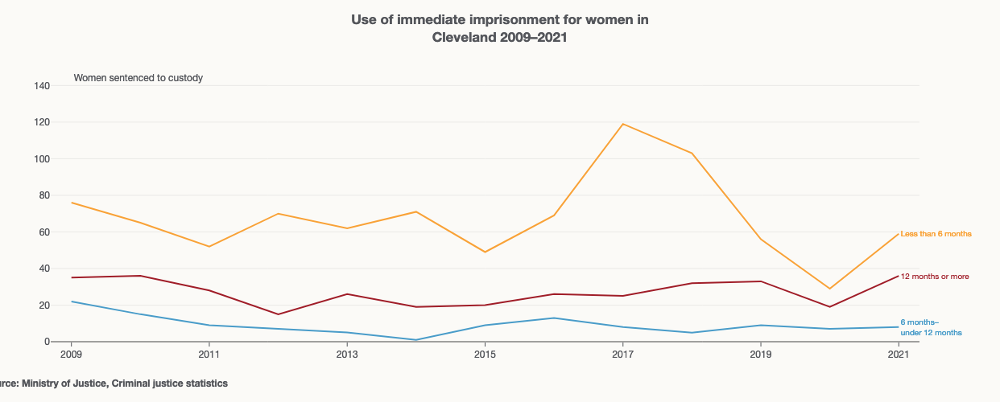

...

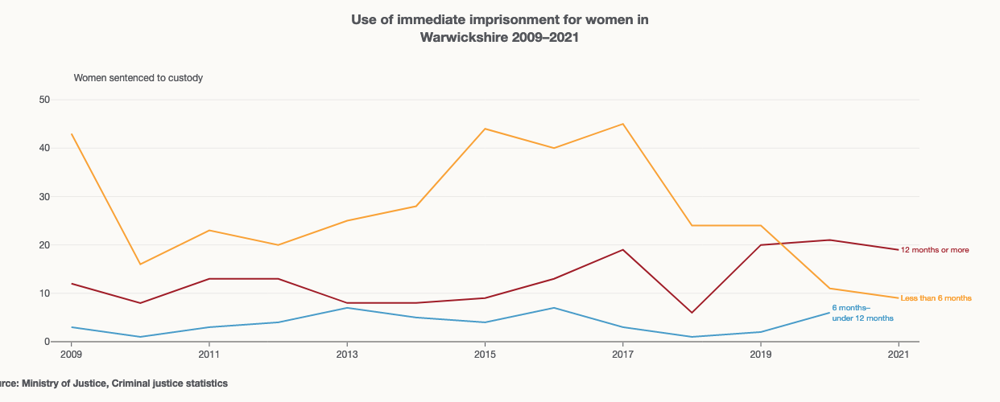

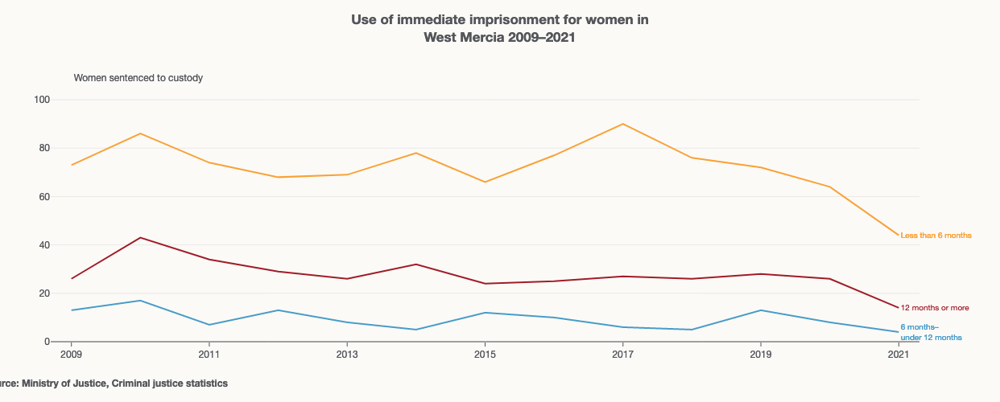

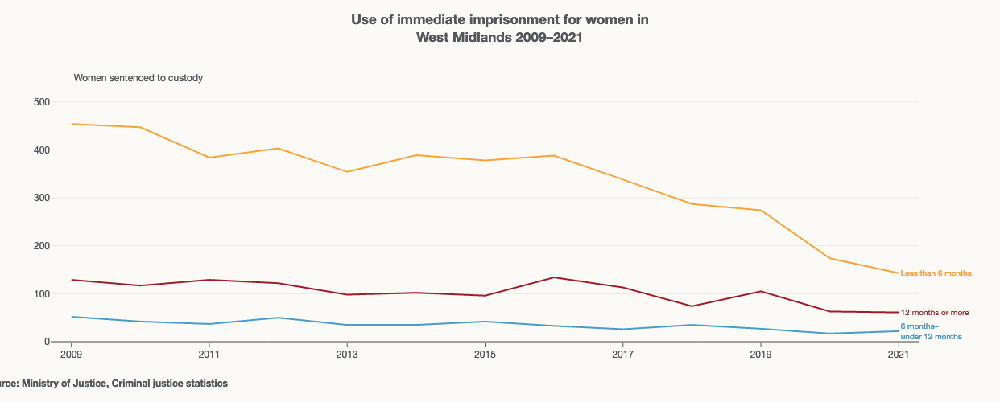

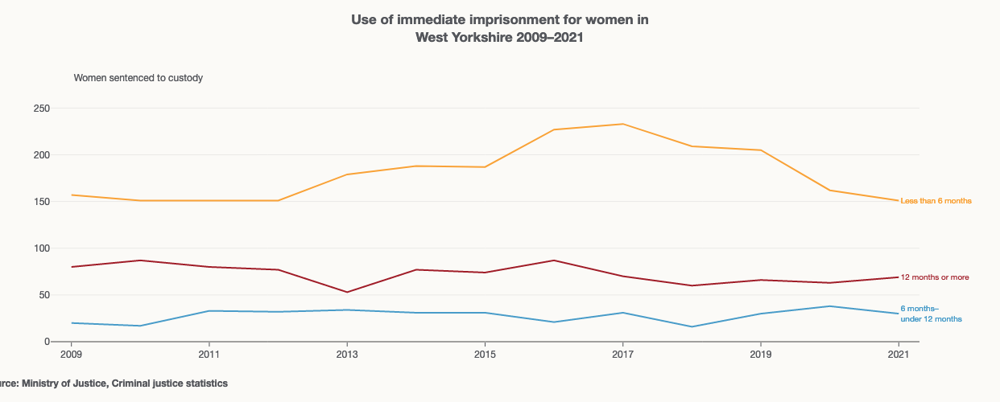

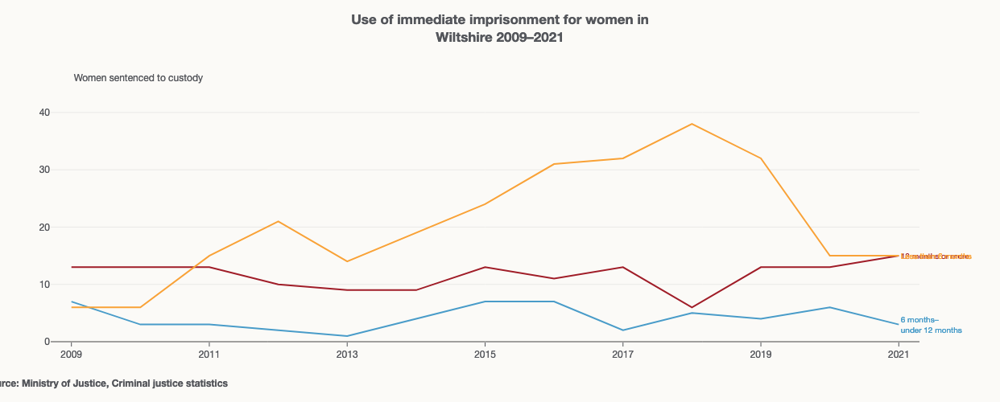

In [122]:
for pfa in df['pfa'].unique():
    pfa_df = df[df["pfa"] == pfa]
    trace_list = [] # Need to empty my trace_list with every loop through each PFA so that charts are plotted separately
    fig = go.Figure() # Need to also instantiate the figure with every loop in order to clear fig.data values

    for i in pfa_df["sentence_len"].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
        pfa_df_sentence = pfa_df[pfa_df["sentence_len"] == i]
        
        trace = go.Scatter(
            x=pfa_df_sentence["year"],
            y=pfa_df_sentence["freq"],
            mode="lines",
            name=str(pfa_df_sentence["sentence_len"].iloc[0]),
            meta=pfa_df_sentence["pfa"].iloc[0],   # Adding name of PFA in metadata to ensure data relates to only one area 
            hovertemplate="%{y}<extra></extra>"
        )

        trace_list.append(trace)

    fig.add_traces(trace_list)

    ## Chart title
    title = textwrap.wrap(f'<b>Use of immediate imprisonment for women in {pfa_df_sentence["pfa"].iloc[0]} 2009–2021</b>', width=45)

    fig.update_layout(
        margin=dict(l=63, b=75, r=100),
        title="<br>".join(title),
        title_y=0.94,
        title_yanchor="bottom",
        yaxis_title="",
        yaxis_tickformat=",.0f",
        yaxis_tick0=0,
        yaxis_nticks=9,
        xaxis_dtick=2,
        xaxis_tick0=2009,    
        xaxis_showgrid=False,
        xaxis_tickcolor="#54565B",
        template=prt_template,
        showlegend=False,
        hovermode="x",
        modebar_activecolor="#A01D28",
        width=655,
        height=500,
    )

    ## Chart annotations
    annotations = []

    # Adding trace annotations
    for j in range(0, len(trace_list)):
        annotations.append(
            dict(
                xref="x",
                yref="y",
                x=fig.data[j].x[-1],
                y=fig.data[j].y[-1],
                text=str(fig.data[j].name),
                xanchor="left",
                align="left",
                showarrow=False,
                font_color=prt_template.layout.colorway[j],
                font_size=10,
            )
        )

    # Adding source label
    annotations.append(
        dict(
            xref="paper",
            yref="paper",
            x=-0.08,
            y=-0.19,
            align="left",
            showarrow=False,
            text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
            font_size=12,
        )
    )

    # Adding y-axis label
    annotations.append(
        dict(
            xref="x",
            yref="paper",
            x=df['year'].iloc[0],
            y=1.04,
            align="left",
            xanchor="left",
            showarrow=False,
            text="Women sentenced to custody",
            font_size=12,
        )
    )

    # Adding annotations to layout
    fig.update_layout(annotations=annotations)


    ## Setting chart axis ranges
    for i in range(len(fig.data)):
        max_trace = (fig.data[i].y).max()
    
    fig.update_yaxes(range=[0, max_trace + (max_trace * 0.2)])
    fig.update_xaxes(range=[2008.7, 2021.3])

    fig.show(config=config)

    ## Exporting to static image

    # Save results to ../reports/figures/custody_sentence_lengths, generate if does not exist.
    export_path = Path.joinpath(Path.cwd().parent, "reports", "figures", "custody_sentence_lengths")
    export_path.mkdir(parents=True, exist_ok=True)

    # Setting filename variable and full path

    filename = str(pfa_df_sentence["pfa"].iloc[0])
    export_svg_path = Path.joinpath(export_path, f'{filename}' + '.svg')

    fig.write_image(export_svg_path)

### Bit of weirdness with a couple of the welsh stats, which needs further investigation.

#### Let's try this with the Welsh PFAs that we know aren't quite working.

In [9]:
filt = df['pfa'] == "Gwent"
df_filt = df[filt]
df_filt

,pfa,year,sentence_len,freq
543,Gwent,2009,12 months or more,14
544,Gwent,2009,6 months–<br>under 12 months,7
545,Gwent,2009,Less than 6 months,49
546,Gwent,2010,12 months or more,12
547,Gwent,2010,6 months–<br>under 12 months,4
548,Gwent,2010,Less than 6 months,43
549,Gwent,2011,12 months or more,18
550,Gwent,2011,6 months–<br>under 12 months,2
551,Gwent,2011,Less than 6 months,49
552,Gwent,2012,12 months or more,14


Numbers appear to be missing for 2020 and 2021, as expected.

Continue digging in separate notebook.

## Chart 2: Imprisonment of women by offence group, 2021

Currently this chart has been using 2019 data up until now for QA. I need to use 2021 offence data now.

### Initial technical planning

#### Note that I'm importing 2019 offences here

In [5]:
df2 = pd.read_csv('../data/processed/PFA_2019_offences.csv')
df2.head()

,pfa,Criminal damage and arson,Drug offences,Fraud Offences,Miscellaneous crimes against society,Not known,Possession of weapons,Public order offences,Robbery,Sexual offences,Summary motoring,Summary non-motoring,Theft Offences,Violence against the person
0,Avon and Somerset,0.013,0.106,0.020,0.079,0.000,0.073,0.033,0.020,0.013,0.020,0.126,0.411,0.086
1,Bedfordshire,0.000,0.000,0.000,0.097,0.000,0.032,0.000,0.032,0.000,0.032,0.065,0.516,0.226
2,Cambridgeshire,0.000,0.022,0.079,0.045,0.011,0.045,0.034,0.045,0.011,0.034,0.146,0.348,0.180
3,Cheshire,0.013,0.121,0.040,0.020,0.000,0.013,0.060,0.013,0.007,0.047,0.087,0.477,0.101
4,Cleveland,0.000,0.031,0.020,0.102,0.010,0.031,0.010,0.112,0.020,0.020,0.051,0.449,0.143


In [4]:
df2.iloc[0].values[1:]

array([0.013, 0.106, 0.02, 0.079, 0.0, 0.073, 0.033, 0.02, 0.013, 0.02,
       0.126, 0.411, 0.086], dtype=object)

In [5]:
df2.columns[1:]

Index(['Criminal damage and arson', 'Drug offences', 'Fraud Offences',
       'Miscellaneous crimes against society', 'Not known',
       'Possession of weapons', 'Public order offences', 'Robbery',
       'Sexual offences', 'Summary motoring', 'Summary non-motoring',
       'Theft Offences', 'Violence against the person'],
      dtype='object')

#### Looks as though there are some offences which have capital letters in there. Let's standardise.

In [5]:
df2.columns = df2.columns.str.capitalize()

In [6]:
df2.columns

Index(['Pfa', 'Criminal damage and arson', 'Drug offences', 'Fraud offences',
       'Miscellaneous crimes against society', 'Not known',
       'Possession of weapons', 'Public order offences', 'Robbery',
       'Sexual offences', 'Summary motoring', 'Summary non-motoring',
       'Theft offences', 'Violence against the person'],
      dtype='object')

In [6]:
df2.columns[0].lower()

'pfa'

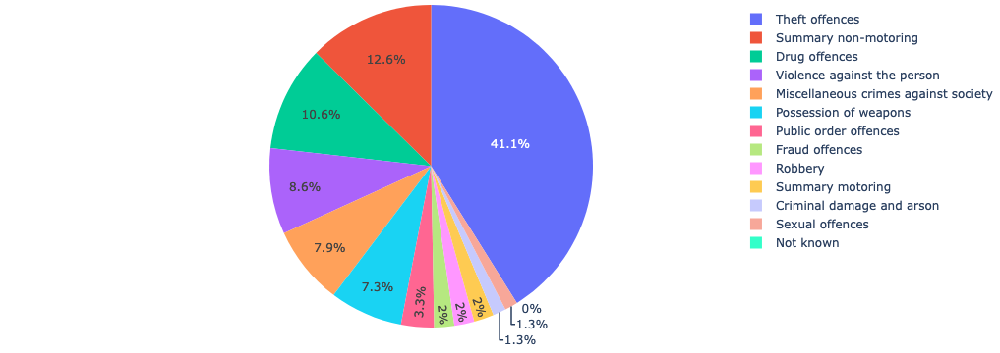

In [7]:
fig = go.Figure(go.Pie(
    labels=df2.columns[1:],
    values=df2.iloc[0].values[1:],
    # branchvalues="total",
))

fig.update_layout(margin = dict(t=0, l=0, r=0, b=0))

fig.show()

In [8]:
df2 = pd.melt(df2, id_vars='Pfa', value_vars=df2.columns[1:], var_name='offence', value_name='proportion')

In [9]:
df2

,Pfa,offence,proportion
0,Avon and Somerset,Criminal damage and arson,0.013
1,Bedfordshire,Criminal damage and arson,0.000
2,Cambridgeshire,Criminal damage and arson,0.000
3,Cheshire,Criminal damage and arson,0.013
4,Cleveland,Criminal damage and arson,0.000
...,...,...,...
541,Warwickshire,Violence against the person,0.130
542,West Mercia,Violence against the person,0.106
543,West Midlands,Violence against the person,0.131
544,West Yorkshire,Violence against the person,0.130


#### Selecting the offences that I want to continue to display at the root of the sunburst diagram

In [10]:
highlighted_offence_groups = ['Theft offences', 'Summary non-motoring', 'Drug offences', 'Violence against the person']
filt = df2['offence'].isin(highlighted_offence_groups)
df2[filt]

,Pfa,offence,proportion
42,Avon and Somerset,Drug offences,0.106
43,Bedfordshire,Drug offences,0.000
44,Cambridgeshire,Drug offences,0.022
45,Cheshire,Drug offences,0.121
46,Cleveland,Drug offences,0.031
...,...,...,...
541,Warwickshire,Violence against the person,0.130
542,West Mercia,Violence against the person,0.106
543,West Midlands,Violence against the person,0.131
544,West Yorkshire,Violence against the person,0.130


In [11]:
df2.loc[filt, 'parent'] = "" # This method prevents that annoying copy/view warning
df2.loc[~filt, 'parent'] = "level 2"
df2

,Pfa,offence,proportion,parent
0,Avon and Somerset,Criminal damage and arson,0.013,level 2
1,Bedfordshire,Criminal damage and arson,0.000,level 2
2,Cambridgeshire,Criminal damage and arson,0.000,level 2
3,Cheshire,Criminal damage and arson,0.013,level 2
4,Cleveland,Criminal damage and arson,0.000,level 2
...,...,...,...,...
541,Warwickshire,Violence against the person,0.130,
542,West Mercia,Violence against the person,0.106,
543,West Midlands,Violence against the person,0.131,
544,West Yorkshire,Violence against the person,0.130,


Let's test this out for one of the PFAs

In [12]:
df2_pfa = df2.query('Pfa == "Bedfordshire"')
df2_pfa

,Pfa,offence,proportion,parent
1,Bedfordshire,Criminal damage and arson,0.000,level 2
43,Bedfordshire,Drug offences,0.000,
85,Bedfordshire,Fraud offences,0.000,level 2
127,Bedfordshire,Miscellaneous crimes against society,0.097,level 2
169,Bedfordshire,Not known,0.000,level 2
211,Bedfordshire,Possession of weapons,0.032,level 2
253,Bedfordshire,Public order offences,0.000,level 2
295,Bedfordshire,Robbery,0.032,level 2
337,Bedfordshire,Sexual offences,0.000,level 2
379,Bedfordshire,Summary motoring,0.032,level 2


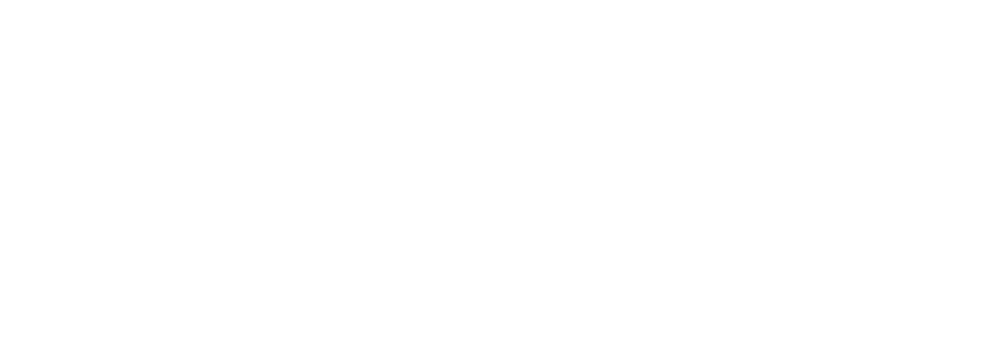

In [13]:
fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues="total",
)
              )
fig.update_layout(margin = dict(t=0, l=0, r=0, b=0))

fig.show()

#### Not displaying. I suspect the issue is that there isn't a parent for the level 2 values to attach themselves to. Try creating an "other offences" category which aggregates all level 2 values.

First though, let's remove all parents and see if we can get this to display

In [14]:
no_parents = []
for i in range(len(df2_pfa)):
    no_parents.append("")
no_parents

['', '', '', '', '', '', '', '', '', '', '', '', '']

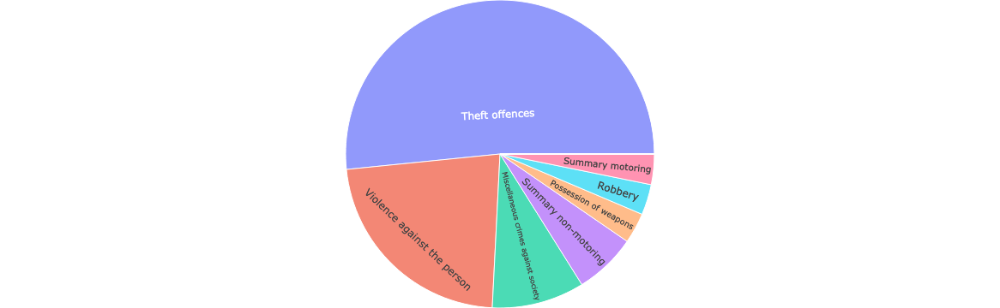

In [15]:
fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=no_parents,
    values=df2_pfa['proportion'],
    branchvalues="total",
)
              )
fig.update_layout(margin = dict(t=0, l=0, r=0, b=0))

fig.show()

Okay, that is good, now let's try to create an aggregate value for those offences that we want to group together

In [16]:
highlighted_offence_groups = ['Theft offences', 'Summary non-motoring', 'Drug offences', 'Violence against the person']
filt = df2_pfa['offence'].isin(highlighted_offence_groups)
df2_pfa[~filt]

,Pfa,offence,proportion,parent
1,Bedfordshire,Criminal damage and arson,0.000,level 2
85,Bedfordshire,Fraud offences,0.000,level 2
127,Bedfordshire,Miscellaneous crimes against society,0.097,level 2
169,Bedfordshire,Not known,0.000,level 2
211,Bedfordshire,Possession of weapons,0.032,level 2
253,Bedfordshire,Public order offences,0.000,level 2
295,Bedfordshire,Robbery,0.032,level 2
337,Bedfordshire,Sexual offences,0.000,level 2
379,Bedfordshire,Summary motoring,0.032,level 2


In [17]:
df2_pfa.loc[~filt, 'proportion'].sum()

0.193

Creating a test append which I could loop

In [18]:
{'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"all other offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':""}

{'Pfa': 'Bedfordshire',
 'offence': 'all other offences',
 'proportion': 0.193,
 'parent': ''}

In [19]:
df2_pfa.append({'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"All other offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':""}, ignore_index=True)

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,level 2
1,Bedfordshire,Drug offences,0.000,
2,Bedfordshire,Fraud offences,0.000,level 2
3,Bedfordshire,Miscellaneous crimes against society,0.097,level 2
4,Bedfordshire,Not known,0.000,level 2
5,Bedfordshire,Possession of weapons,0.032,level 2
6,Bedfordshire,Public order offences,0.000,level 2
7,Bedfordshire,Robbery,0.032,level 2
8,Bedfordshire,Sexual offences,0.000,level 2
9,Bedfordshire,Summary motoring,0.032,level 2


Let's test this again

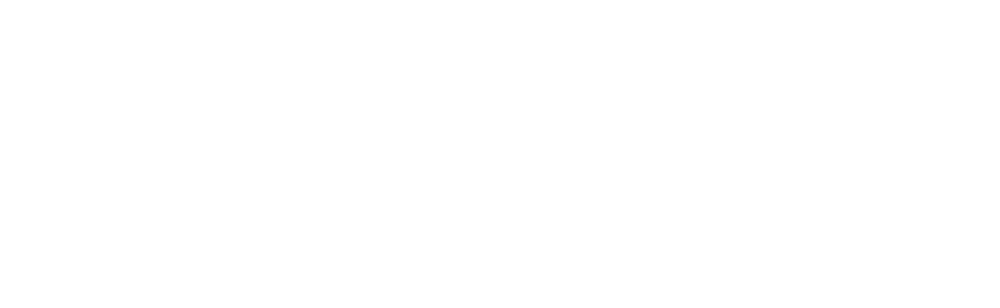

In [20]:
fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues="total",
)
              )
fig.update_layout(margin = dict(t=0, l=0, r=0, b=0))

fig.show()

Hmmmmm, still not working

In [21]:
df2_pfa

,Pfa,offence,proportion,parent
1,Bedfordshire,Criminal damage and arson,0.000,level 2
43,Bedfordshire,Drug offences,0.000,
85,Bedfordshire,Fraud offences,0.000,level 2
127,Bedfordshire,Miscellaneous crimes against society,0.097,level 2
169,Bedfordshire,Not known,0.000,level 2
211,Bedfordshire,Possession of weapons,0.032,level 2
253,Bedfordshire,Public order offences,0.000,level 2
295,Bedfordshire,Robbery,0.032,level 2
337,Bedfordshire,Sexual offences,0.000,level 2
379,Bedfordshire,Summary motoring,0.032,level 2


Ahhhhh, it's not saved that new value. Let's rectify.

In [23]:
df2_pfa = df2_pfa.append({'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"All other offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':""}, ignore_index=True)

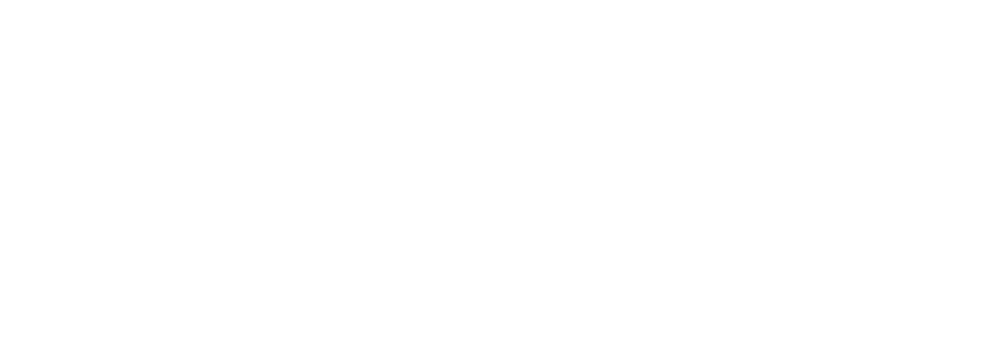

In [24]:
fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues="total",
)
              )
fig.update_layout(margin = dict(t=0, l=0, r=0, b=0))

fig.show()

In [25]:
df2_pfa

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,level 2
1,Bedfordshire,Drug offences,0.000,
2,Bedfordshire,Fraud offences,0.000,level 2
3,Bedfordshire,Miscellaneous crimes against society,0.097,level 2
4,Bedfordshire,Not known,0.000,level 2
5,Bedfordshire,Possession of weapons,0.032,level 2
6,Bedfordshire,Public order offences,0.000,level 2
7,Bedfordshire,Robbery,0.032,level 2
8,Bedfordshire,Sexual offences,0.000,level 2
9,Bedfordshire,Summary motoring,0.032,level 2


Right, need to asign "All other offences" as the parent of those other values, rather than "level 2"

In [28]:
df2_pfa['parent'] = df2_pfa['parent'].str.replace("level 2", "All other offences")
df2_pfa

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,All other offences
1,Bedfordshire,Drug offences,0.000,
2,Bedfordshire,Fraud offences,0.000,All other offences
3,Bedfordshire,Miscellaneous crimes against society,0.097,All other offences
4,Bedfordshire,Not known,0.000,All other offences
5,Bedfordshire,Possession of weapons,0.032,All other offences
6,Bedfordshire,Public order offences,0.000,All other offences
7,Bedfordshire,Robbery,0.032,All other offences
8,Bedfordshire,Sexual offences,0.000,All other offences
9,Bedfordshire,Summary motoring,0.032,All other offences


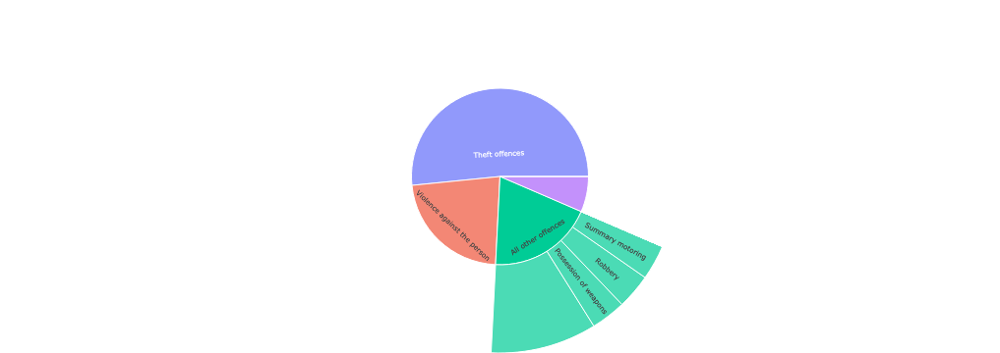

In [33]:
fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues="total",
)
              )
fig.update_layout(
    margin = dict(t=0, l=0, r=0, b=0),
    uniformtext=dict(minsize=6, mode='hide')
)

fig.show()

### Great, the concept works. Now to tidy up all of the steps up to this point.

In [40]:
df2 = pd.read_csv('../data/processed/PFA_2019_offences.csv')
df2.columns = df2.columns.str.capitalize() #Standardising case

#Melting df2 from wide to long
df2 = pd.melt(df2, id_vars='Pfa', value_vars=df2.columns[1:], var_name='offence', value_name='proportion')

#Selecting the offences that I want to continue to display at the root of the sunburst diagram
highlighted_offence_groups = ['Theft offences', 'Summary non-motoring', 'Drug offences', 'Violence against the person']
filt = df2['offence'].isin(highlighted_offence_groups)

df2.loc[filt, 'parent'] = "All offences" # This method prevents that annoying copy/view warning
df2.loc[~filt, 'parent'] = "All other offences"

#Selecting a sub-group for testing
df2_pfa = df2.query('Pfa == "Bedfordshire"')
filt = df2_pfa['offence'].isin(highlighted_offence_groups)

#Creating an aggregate parent value for the highlighted_offence_groups
df2_pfa = df2_pfa.append({'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"All other<br>offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':"All offences"}, ignore_index=True)

In [41]:
df2_pfa

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,All other offences
1,Bedfordshire,Drug offences,0.000,All offences
2,Bedfordshire,Fraud offences,0.000,All other offences
3,Bedfordshire,Miscellaneous crimes against society,0.097,All other offences
4,Bedfordshire,Not known,0.000,All other offences
5,Bedfordshire,Possession of weapons,0.032,All other offences
6,Bedfordshire,Public order offences,0.000,All other offences
7,Bedfordshire,Robbery,0.032,All other offences
8,Bedfordshire,Sexual offences,0.000,All other offences
9,Bedfordshire,Summary motoring,0.032,All other offences


In [42]:
df2_pfa['offence'] = df2_pfa['offence'].replace(
    {"Violence against the person": "Violence against<br>the person",
    "all other offences": "all other<br>offences",
     "Possession of weapons": "Possession<br>of weapons",
     "Summary motoring": "Summary<br>motoring",
     "Summary non-motoring": "Summary<br>non-motoring",
     "Miscellaneous crimes against society": "Miscellaneous crimes<br>against society"}, regex=True)
df2_pfa

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,All other offences
1,Bedfordshire,Drug offences,0.000,All offences
2,Bedfordshire,Fraud offences,0.000,All other offences
3,Bedfordshire,Miscellaneous crimes<br>against society,0.097,All other offences
4,Bedfordshire,Not known,0.000,All other offences
5,Bedfordshire,Possession<br>of weapons,0.032,All other offences
6,Bedfordshire,Public order offences,0.000,All other offences
7,Bedfordshire,Robbery,0.032,All other offences
8,Bedfordshire,Sexual offences,0.000,All other offences
9,Bedfordshire,Summary<br>motoring,0.032,All other offences


In [43]:
df2_pfa['parent'] = df2_pfa['parent'].replace("All other offences", "All other<br>offences", regex=True)

In [44]:
df2_pfa

,Pfa,offence,proportion,parent
0,Bedfordshire,Criminal damage and arson,0.000,All other<br>offences
1,Bedfordshire,Drug offences,0.000,All offences
2,Bedfordshire,Fraud offences,0.000,All other<br>offences
3,Bedfordshire,Miscellaneous crimes<br>against society,0.097,All other<br>offences
4,Bedfordshire,Not known,0.000,All other<br>offences
5,Bedfordshire,Possession<br>of weapons,0.032,All other<br>offences
6,Bedfordshire,Public order offences,0.000,All other<br>offences
7,Bedfordshire,Robbery,0.032,All other<br>offences
8,Bedfordshire,Sexual offences,0.000,All other<br>offences
9,Bedfordshire,Summary<br>motoring,0.032,All other<br>offences


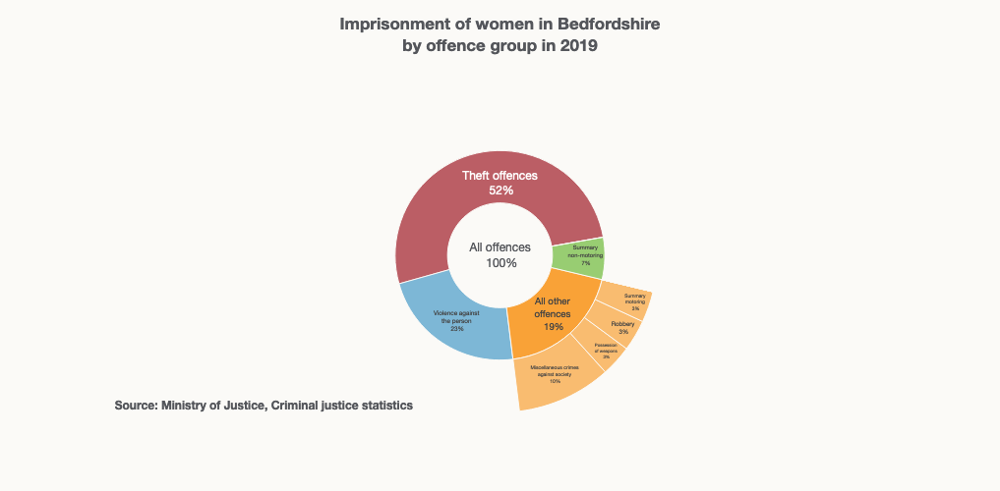

In [45]:
## Chart title
title = textwrap.wrap(f'<b>Imprisonment of women in {df2_pfa["Pfa"].iloc[0]} by offence group in 2019</b>', width=40)

fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues='total',
    texttemplate="%{label}<br>%{percentRoot: .0%}",
    hovertemplate="<b>%{label}</b><br>%{percentParent: .0%} of %{parent}<extra></extra>",
    hoverinfo='label+percent parent',
    insidetextorientation='horizontal',
    rotation=10

)
              )
fig.update_layout(
#     margin = dict(t=60, l=0, r=0, b=20),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    template = prt_template,
    # uniformtext=dict(minsize=6.6, mode='hide'),
    width=655,
    height=500,
)

## Chart annotations
annotations = []
# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=0.04,
        y=-0.01,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)
# Adding annotations to layout
fig.update_layout(annotations=annotations)
fig.update_yaxes(automargin=True)

fig.show(config=config)

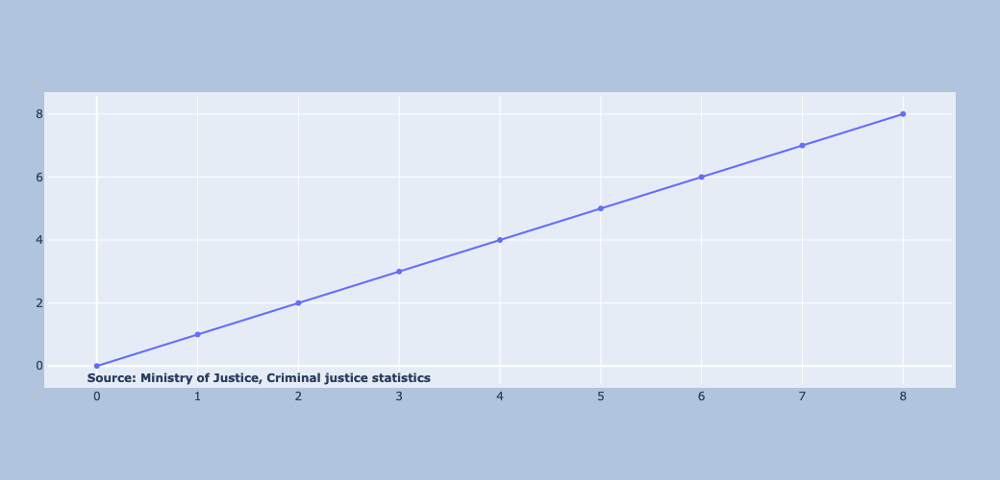

In [13]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=[0, 1, 2, 3, 4, 5, 6, 7, 8],
    y=[0, 1, 2, 3, 4, 5, 6, 7, 8]
))

fig.update_layout(
    autosize=False,
    width=500,
    height=500,
    margin=dict(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    paper_bgcolor="LightSteelBlue",
)

## Chart annotations
annotations = []
# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=0.04,
        y=-0.01,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)
# Adding annotations to layout
fig.update_layout(annotations=annotations)

fig.show()

#### Fact check some of the other PFA for 2019 before developing further.

In [46]:
#Selecting a sub-group for testing
df2_pfa = df2.query('Pfa == "Sussex"')
filt = df2_pfa['offence'].isin(highlighted_offence_groups)

#Creating an aggregate parent value for the highlighted_offence_groups
df2_pfa = df2_pfa.append({'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"All other<br>offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':"All offences"}, ignore_index=True)

In [47]:
df2_pfa['offence'] = df2_pfa['offence'].replace(
    {"Violence against the person": "Violence against<br>the person",
    "all other offences": "all other<br>offences",
     "Possession of weapons": "Possession<br>of weapons",
     "Summary motoring": "Summary<br>motoring",
     "Summary non-motoring": "Summary<br>non-motoring",
     "Miscellaneous crimes against society": "Miscellaneous crimes<br>against society"}, regex=True)

df2_pfa['parent'] = df2_pfa['parent'].replace("All other offences", "All other<br>offences", regex=True)
df2_pfa

,Pfa,offence,proportion,parent
0,Sussex,Criminal damage and arson,0.024,All other<br>offences
1,Sussex,Drug offences,0.082,All offences
2,Sussex,Fraud offences,0.071,All other<br>offences
3,Sussex,Miscellaneous crimes<br>against society,0.059,All other<br>offences
4,Sussex,Not known,0.000,All other<br>offences
5,Sussex,Possession<br>of weapons,0.047,All other<br>offences
6,Sussex,Public order offences,0.035,All other<br>offences
7,Sussex,Robbery,0.082,All other<br>offences
8,Sussex,Sexual offences,0.012,All other<br>offences
9,Sussex,Summary<br>motoring,0.012,All other<br>offences


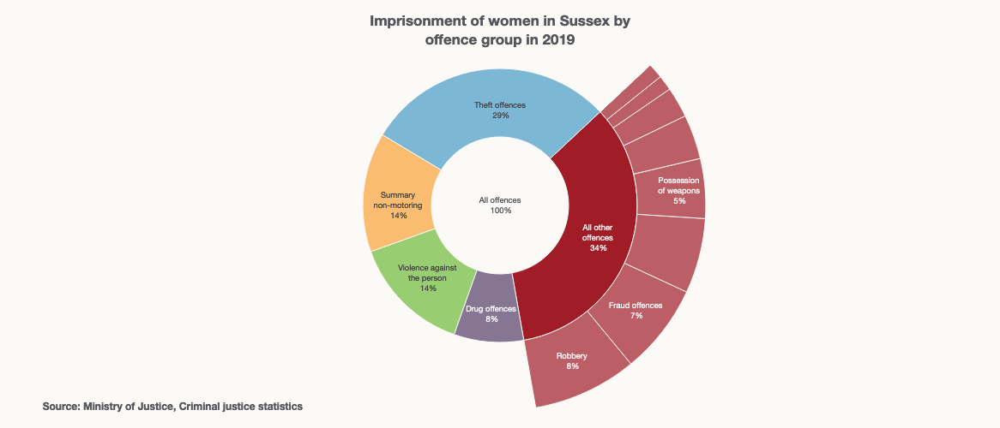

In [48]:
## Chart title
title = textwrap.wrap(f'<b>Imprisonment of women in {df2_pfa["Pfa"].iloc[0]} by offence group in 2019</b>', width=40)

fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues='total',
    texttemplate="%{label}<br>%{percentRoot: .0%}",
    hovertemplate="<b>%{label}</b><br>%{percentParent: .0%} of %{parent}<extra></extra>",
    hoverinfo='label+percent parent',
    insidetextorientation='horizontal',
    rotation=280

)
              )
fig.update_layout(
    margin = dict(t=0, l=0, r=0, b=20),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    template = prt_template,
    uniformtext=dict(minsize=8, mode='hide'),
    width=655,
    height=500,
)

## Chart annotations
annotations = []
# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=0.04,
        y=-0.01,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)
# Adding annotations to layout
fig.update_layout(annotations=annotations)

fig.show(config=config)

#### Different colours are being used for offence groups between the charts, so let's create a dictionary to map our colours for consistency.

In [49]:
#Selecting a sub-group for testing
df2_pfa = df2.query('Pfa == "Humberside"')
filt = df2_pfa['offence'].isin(highlighted_offence_groups)

#Creating an aggregate parent value for the highlighted_offence_groups
df2_pfa = df2_pfa.append({'Pfa': df2_pfa['Pfa'].iloc[0], 'offence':"All other<br>offences", 'proportion': df2_pfa.loc[~filt, 'proportion'].sum(), 'parent':"All offences"}, ignore_index=True)

In [50]:
df2_pfa['offence'] = df2_pfa['offence'].replace(
    {"Violence against the person": "Violence against<br>the person",
    "all other offences": "all other<br>offences",
     "Possession of weapons": "Possession<br>of weapons",
     "Summary motoring": "Summary<br>motoring",
     "Summary non-motoring": "Summary<br>non-motoring",
     "Miscellaneous crimes against society": "Miscellaneous crimes<br>against society"}, regex=True)

df2_pfa['parent'] = df2_pfa['parent'].replace("All other offences", "All other<br>offences", regex=True)
df2_pfa

,Pfa,offence,proportion,parent
0,Humberside,Criminal damage and arson,0.000,All other<br>offences
1,Humberside,Drug offences,0.047,All offences
2,Humberside,Fraud offences,0.047,All other<br>offences
3,Humberside,Miscellaneous crimes<br>against society,0.023,All other<br>offences
4,Humberside,Not known,0.000,All other<br>offences
5,Humberside,Possession<br>of weapons,0.054,All other<br>offences
6,Humberside,Public order offences,0.031,All other<br>offences
7,Humberside,Robbery,0.023,All other<br>offences
8,Humberside,Sexual offences,0.000,All other<br>offences
9,Humberside,Summary<br>motoring,0.008,All other<br>offences


In [51]:
df2_pfa.sort_values(by=["proportion"], ascending=False, inplace=True)

In [52]:
filt = df2_pfa['parent'] == "All offences"
df2_pfa[filt]['offence']

11                    Theft offences
13             All other<br>offences
12    Violence against<br>the person
1                      Drug offences
10           Summary<br>non-motoring
Name: offence, dtype: object

In [53]:
donut_cols = {}
for i in range(len(df2_pfa[filt]['offence'])):
        donut_cols[df2_pfa[filt]['offence'].iloc[i]] = prt_template.layout.colorway[i]
    
for i in range(len(df2_pfa[~filt]['offence'])):
    donut_cols[df2_pfa[~filt]['offence'].iloc[i]] = prt_template.layout.colorway[1]    

donut_cols

{'Theft offences': '#A01D28',
 'All other<br>offences': '#499CC9',
 'Violence against<br>the person': '#F9A237',
 'Drug offences': '#6FBA3A',
 'Summary<br>non-motoring': '#573D6B',
 'Possession<br>of weapons': '#499CC9',
 'Fraud offences': '#499CC9',
 'Public order offences': '#499CC9',
 'Miscellaneous crimes<br>against society': '#499CC9',
 'Robbery': '#499CC9',
 'Summary<br>motoring': '#499CC9',
 'Criminal damage and arson': '#499CC9',
 'Not known': '#499CC9',
 'Sexual offences': '#499CC9'}

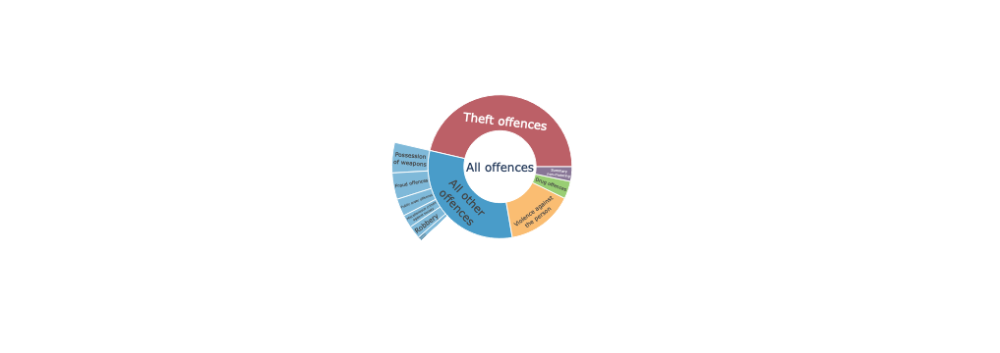

In [54]:
import plotly.express as px

## Chart title
title = textwrap.wrap(f'<b>Imprisonment of women in {df2_pfa["Pfa"].iloc[0]} by offence group in 2019</b>', width=40)

fig = px.sunburst(df2_pfa, names='offence', values='proportion', parents='parent', color='offence',
                  color_discrete_map=donut_cols)

fig.show()

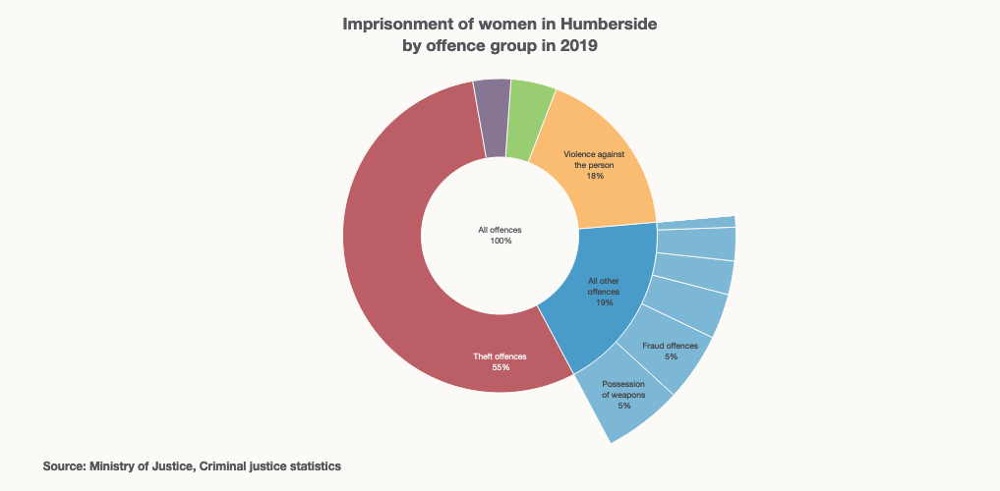

In [62]:
## Chart title
title = textwrap.wrap(f'<b>Imprisonment of women in {df2_pfa["Pfa"].iloc[0]} by offence group in 2019</b>', width=40)

fig =go.Figure(go.Sunburst(
    labels=df2_pfa['offence'],
    parents=df2_pfa['parent'],
    values=df2_pfa['proportion'],
    branchvalues='total',
    texttemplate="%{label}<br>%{percentRoot: .0%}",
    hovertemplate="<b>%{label}</b><br>%{percentParent: .0%} of %{parent}<extra></extra>",
    hoverinfo='label+percent parent',
    insidetextorientation='horizontal',
    rotation=100,
)
              )
fig.update_layout(
    margin = dict(t=0, l=0, r=0, b=20),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    template = prt_template,
    uniformtext=dict(minsize=8, mode='hide'),
    width=655,
    height=500,
)

## Chart annotations
annotations = []
# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=0.04,
        y=-0.01,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)
# Adding annotations to layout
fig.update_layout(annotations=annotations)

fig.show(config=config)

#### Let's expand my earlier changes to the whole dataframe

In [56]:
#Selecting the offences that I want to continue to display at the root of the sunburst diagram
highlighted_offence_groups = ['Theft offences', 'Summary non-motoring', 'Drug offences', 'Violence against the person']
filt = df2['offence'].isin(highlighted_offence_groups)

df2.loc[filt, 'parent'] = "All offences" # This method prevents that annoying copy/view warning
df2.loc[~filt, 'parent'] = "All other offences"

### Consolidating changes up to this point

In [129]:
#Adding line breaks to longer offence categories

df2['offence'] = df2['offence'].replace(
    {"Violence against the person": "Violence against<br>the person",
    "all other offences": "all other<br>offences",
     "Theft offences": "Theft<br>offences",
     "Drug offences": "Drug<br>offences",
     "Possession of weapons": "Possession<br>of weapons",
     "Summary motoring": "Summary<br>motoring",
     "Summary non-motoring": "Summary<br>non-motoring",
     "Miscellaneous crimes against society": "Miscellaneous crimes<br>against society"}, regex=True)

#Selecting the offences that I want to continue to display at the root of the sunburst diagram
highlighted_offence_groups = ['Theft<br>offences', 'Drug<br>offences', 'Violence against<br>the person']
filt = df2['offence'].isin(highlighted_offence_groups)

df2.loc[filt, 'parent'] = "All offences" # This method prevents that annoying copy/view warning
df2.loc[~filt, 'parent'] = "All other<br>offences"

#### This is the final working loop

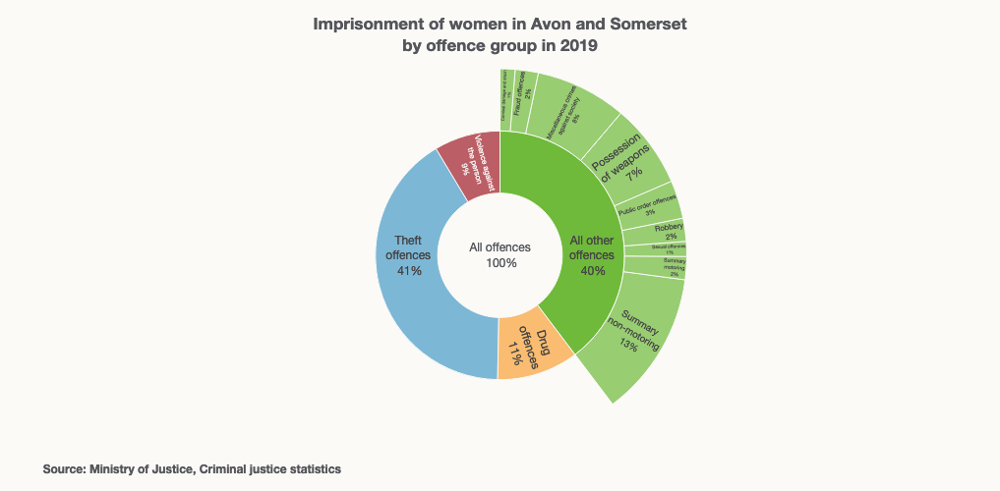

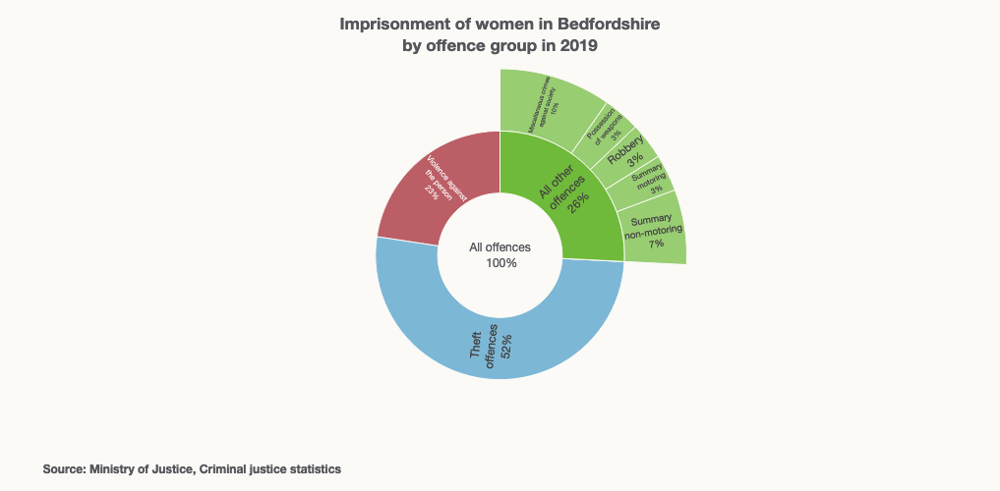

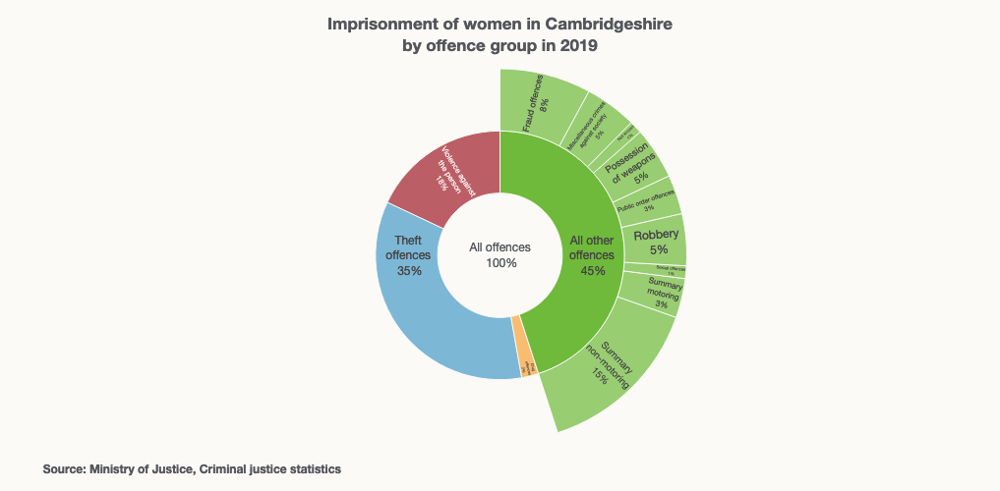

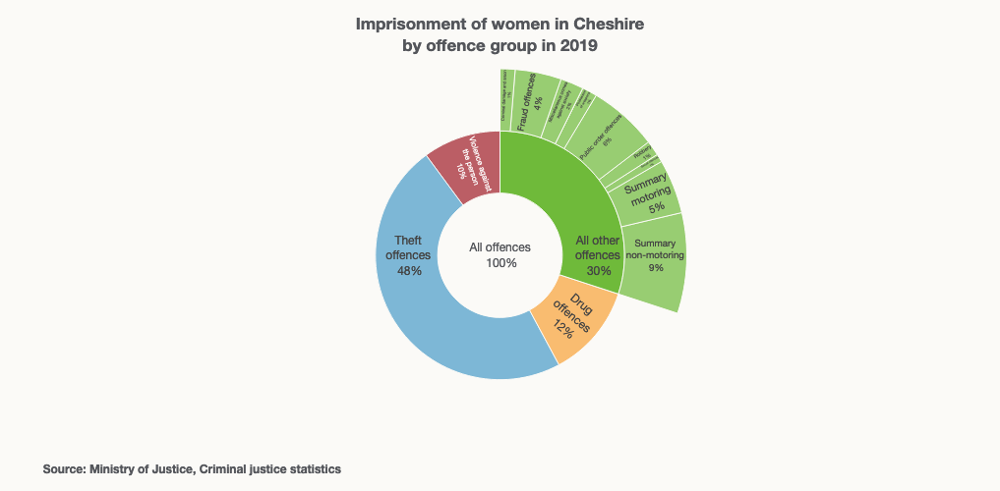

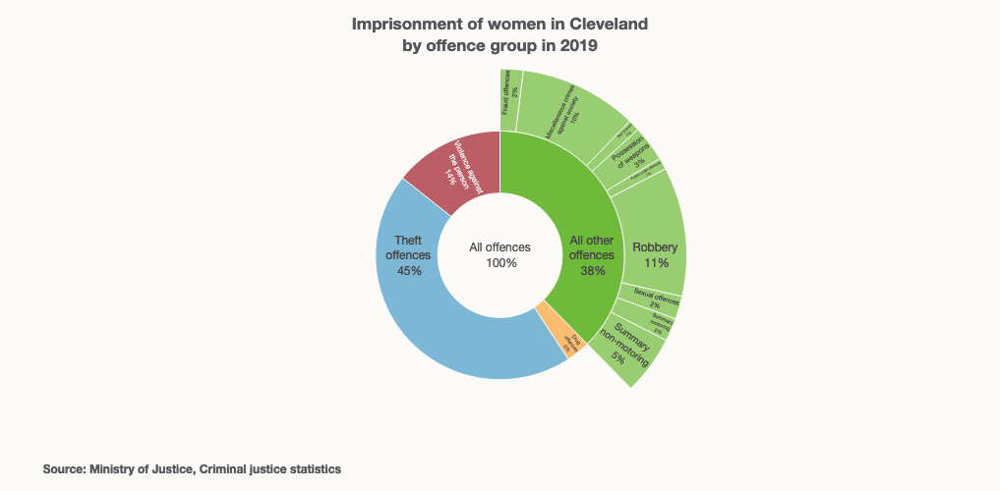

...

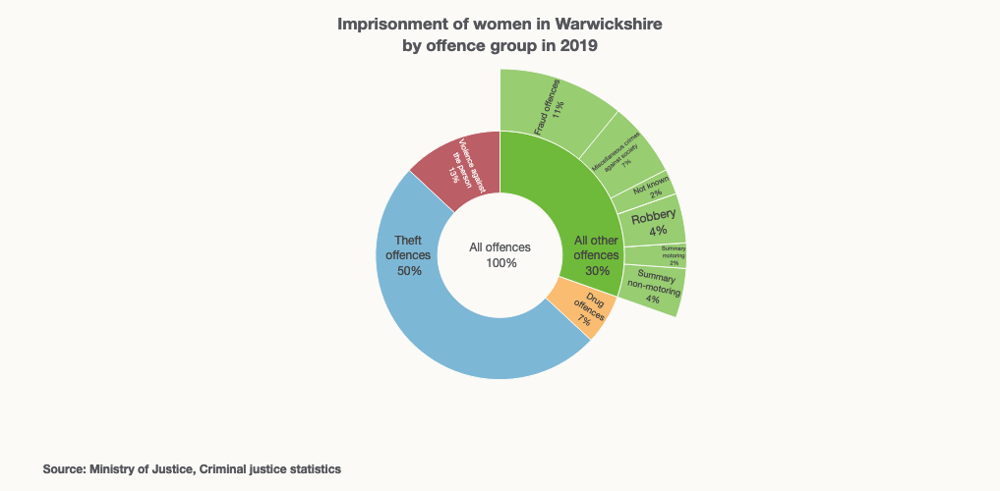

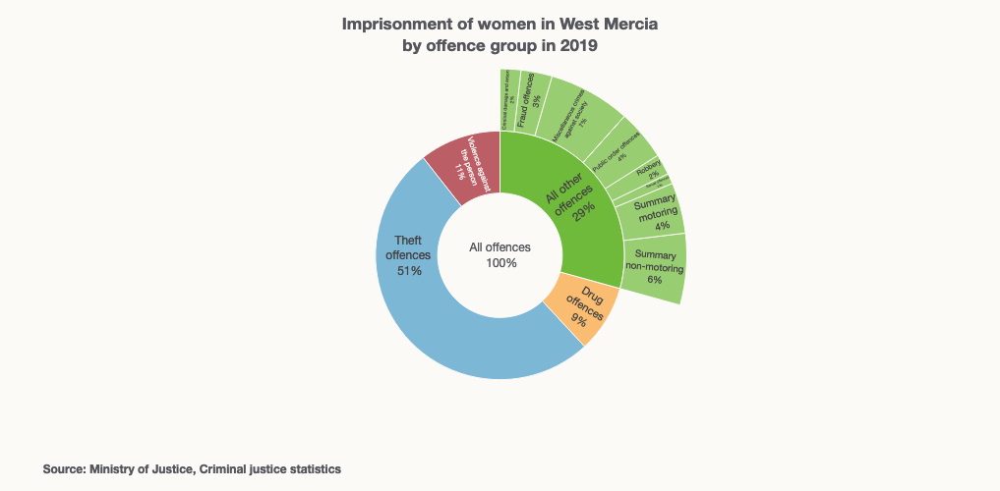

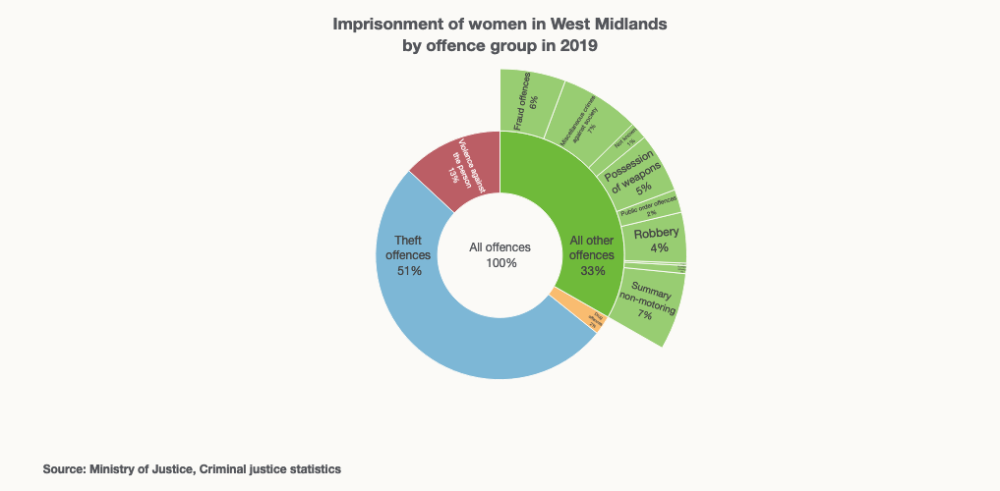

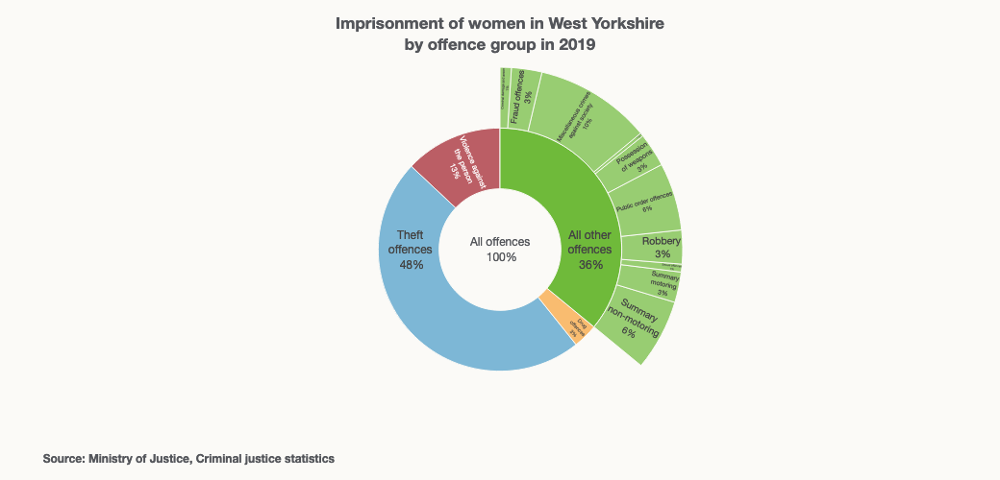

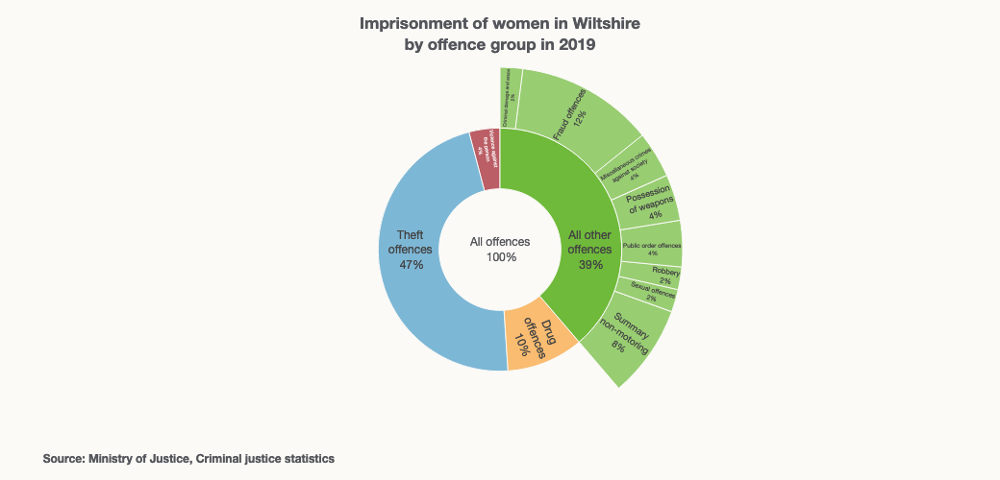

In [161]:
for pfa in df2['Pfa'].unique():
    pfa_df = df2[df2["Pfa"] == pfa]
    #Creating an aggregate parent value for the highlighted_offence_groups
    pfa_df = pfa_df.append({'Pfa': pfa_df['Pfa'].iloc[0], 'offence':"All other<br>offences", 'proportion': pfa_df.loc[~filt, 'proportion'].sum(), 'parent':"All offences"}, ignore_index=True).sort_values(by=['offence'], ascending=False)    
        
        
    ## Chart title
    title = textwrap.wrap(f'<b>Imprisonment of women in {pfa_df["Pfa"].iloc[0]}<br>by offence group in 2019</b>', width=100)

    fig =go.Figure(go.Sunburst(
        labels=pfa_df['offence'],
        parents=pfa_df['parent'],
        values=pfa_df['proportion'],
        branchvalues='total',
        texttemplate="%{label}<br>%{percentRoot: .0%}",
        hovertemplate="<b>%{label}</b><br>%{percentParent: .0%} of %{parent}<extra></extra>",
        hoverinfo='label+percent parent',
        insidetextorientation='radial',
        rotation=90,
    )
                  )
    
    fig.update_traces(sort=False)
    
    fig.update_layout(
    margin = dict(t=70, l=0, r=0, b=50),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    template = prt_template,
    width=655,
    height=500,
    )

    ## Chart annotations
    annotations = []
    # Adding source label
    annotations.append(
        dict(
            xref="paper",
            yref="paper",
            x=0.04,
            y=-0.1,
            align="left",
            showarrow=False,
            text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
            font_size=12,
        )
    )
    # Adding annotations to layout
    fig.update_layout(annotations=annotations)

    fig.show(config=config)

In [99]:
cam = df2.query('Pfa == "Cambridgeshire"')
cam

,Pfa,offence,proportion,parent
2,Cambridgeshire,Criminal damage and arson,0.000,All other offences
44,Cambridgeshire,Drug offences,0.022,All offences
86,Cambridgeshire,Fraud offences,0.079,All other offences
128,Cambridgeshire,Miscellaneous crimes<br>against society,0.045,All other offences
170,Cambridgeshire,Not known,0.011,All other offences
212,Cambridgeshire,Possession<br>of weapons,0.045,All other offences
254,Cambridgeshire,Public order offences,0.034,All other offences
296,Cambridgeshire,Robbery,0.045,All other offences
338,Cambridgeshire,Sexual offences,0.011,All other offences
380,Cambridgeshire,Summary<br>motoring,0.034,All other offences


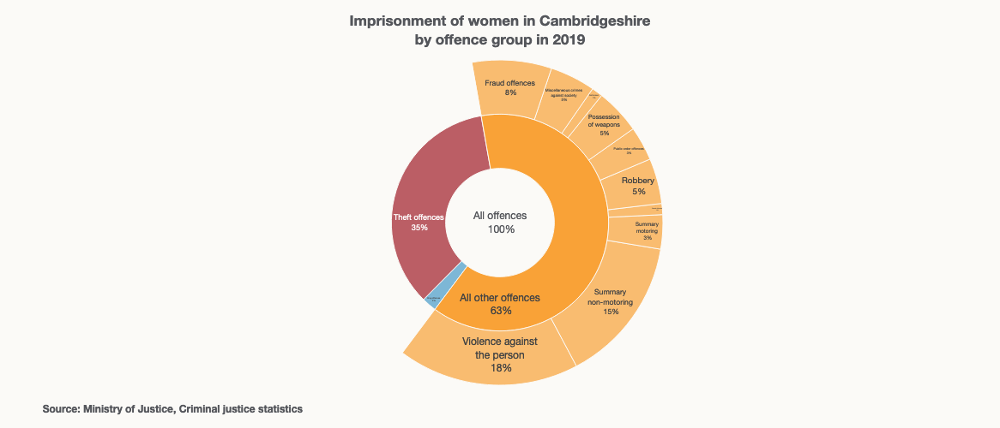

In [113]:
cam = df2.query('Pfa == "Cambridgeshire"')
#Creating an aggregate parent value for the highlighted_offence_groups
cam = cam.append({'Pfa': cam['Pfa'].iloc[0], 'offence':"All other offences", 'proportion': cam.loc[~filt, 'proportion'].sum(), 'parent':"All offences"}, ignore_index=True).sort_values(by=['offence'], ascending=False)    


## Chart title
title = textwrap.wrap(f'<b>Imprisonment of women in {cam["Pfa"].iloc[0]}<br>by offence group in 2019</b>', width=100)

fig =go.Figure(go.Sunburst(
    labels=cam['offence'],
    parents=cam['parent'],
    values=cam['proportion'],
    branchvalues='total',
    texttemplate="%{label}<br>%{percentRoot: .0%}",
    hovertemplate="<b>%{label}</b><br>%{percentParent: .0%} of %{parent}<extra></extra>",
    hoverinfo='label+percent parent',
    insidetextorientation='horizontal',
    rotation=100,
    textfont_size=12,
)
              )

fig.update_traces(sort=False)

fig.update_layout(
    margin = dict(t=70, l=0, r=0, b=50),
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    template = prt_template,
#     uniformtext=dict(minsize=6, mode='hide'),
    width=655,
    height=500,
)

## Chart annotations
annotations = []
# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=0.04,
        y=-0.1,
        align="left",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal justice statistics</b>",
        font_size=12,
    )
)
# Adding annotations to layout
fig.update_layout(annotations=annotations)

fig.show(config=config)

## Chart 3: Sentencing of women to Community Orders, Suspended Sentences and Immediate Imprisonment, 2009-2021

In [21]:
df3 = pd.read_csv('../data/processed/PFA_2009-21_women_cust_comm_sus_FINAL.csv')
df3

,pfa,year,outcome,freq
0,Avon and Somerset,2009,Community sentence,592
1,Avon and Somerset,2009,Immediate custody,165
2,Avon and Somerset,2009,Suspended sentence,158
3,Avon and Somerset,2010,Community sentence,618
4,Avon and Somerset,2010,Immediate custody,173
...,...,...,...,...
1633,Wiltshire,2020,Immediate custody,34
1634,Wiltshire,2020,Suspended sentence,31
1635,Wiltshire,2021,Community sentence,142
1636,Wiltshire,2021,Immediate custody,33


In [23]:
#Selecting a sub-group for testing
df3_pfa = df3.query('pfa == "Bedfordshire"')

In [24]:
df3_pfa.head()

,pfa,year,outcome,freq
39,Bedfordshire,2009,Community sentence,206
40,Bedfordshire,2009,Immediate custody,64
41,Bedfordshire,2009,Suspended sentence,61
42,Bedfordshire,2010,Community sentence,187
43,Bedfordshire,2010,Immediate custody,99


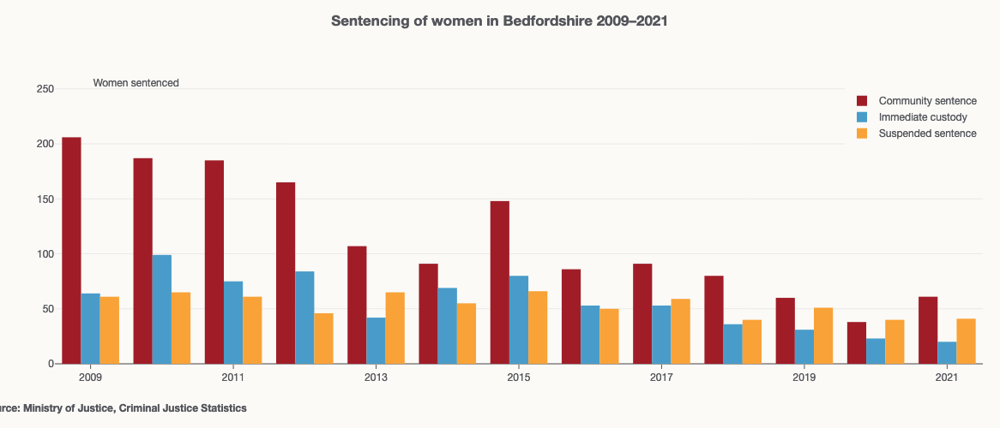

In [61]:
## Chart title
title = textwrap.wrap(f'<b>Sentencing of women in {df3_pfa["pfa"].iloc[0]} 2009–2021</b>', width=60)

## Plotting

fig = go.Figure()

trace_list = []
for i in df3_pfa[
    "outcome"
].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
    df3_sentence = df3_pfa[df3_pfa["outcome"] == i]

    trace = go.Bar(
        x=df3_sentence["year"],
        y=df3_sentence["freq"],
        name=str(df3_sentence["outcome"].iloc[0]),
        customdata=df3_sentence["outcome"].str.lower(),
        hovertemplate="%{y} %{customdata}<extra></extra>",
    )

    trace_list.append(trace)

fig.add_traces(trace_list)

fig.update_layout(
    margin=dict(l=64, b=75, r=20),
    barmode="group",
    title="<br>".join(title),
    title_y=0.94,
    title_yanchor="bottom",
    yaxis_title="",
    yaxis_tick0=0,
    yaxis_tickformat=",.0f",
    xaxis_showgrid=False,
    xaxis_tickcolor="#54565B",
    xaxis_dtick=2,
    xaxis_tick0=2009,
    template=prt_template,
    showlegend=True,
    hovermode="x",
    modebar_activecolor="#A01D28",
    width=655,
    height=500,
)

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="right",
    x=1
))

## Chart annotations
annotations = []

# Adding source label
annotations.append(
    dict(
        xref="paper",
        yref="paper",
        x=-0.08,
        y=-0.19,
        align="left",
        yanchor="bottom",
        showarrow=False,
        text="<b>Source: Ministry of Justice, Criminal Justice Statistics</b>",
        font_size=12,
    )
)

# Adding y-axis label
annotations.append(
    dict(
        xref="x",
        yref="paper",
        x=df3_sentence["year"].iloc[0],
        y=1.04,
        align="left",
        xanchor="left",
        showarrow=False,
        text="Women sentenced",
        font_size=12,
    )
)

# Adding annotations to layout
fig.update_layout(annotations=annotations)

## Setting chart axis ranges
fig.update_yaxes(range=[0, 253])

fig.show(config=config)

#### Now building a loop

In [62]:
filt=df3['pfa'].isin(["Gwent", "Derbyshire", "Lancashire"])
df_filt = df3[filt]

In [63]:
df_filt

,pfa,year,outcome,freq
234,Derbyshire,2009,Community sentence,391
235,Derbyshire,2009,Immediate custody,120
236,Derbyshire,2009,Suspended sentence,126
237,Derbyshire,2010,Community sentence,408
238,Derbyshire,2010,Immediate custody,131
...,...,...,...,...
775,Lancashire,2020,Immediate custody,113
776,Lancashire,2020,Suspended sentence,114
777,Lancashire,2021,Community sentence,337
778,Lancashire,2021,Immediate custody,147


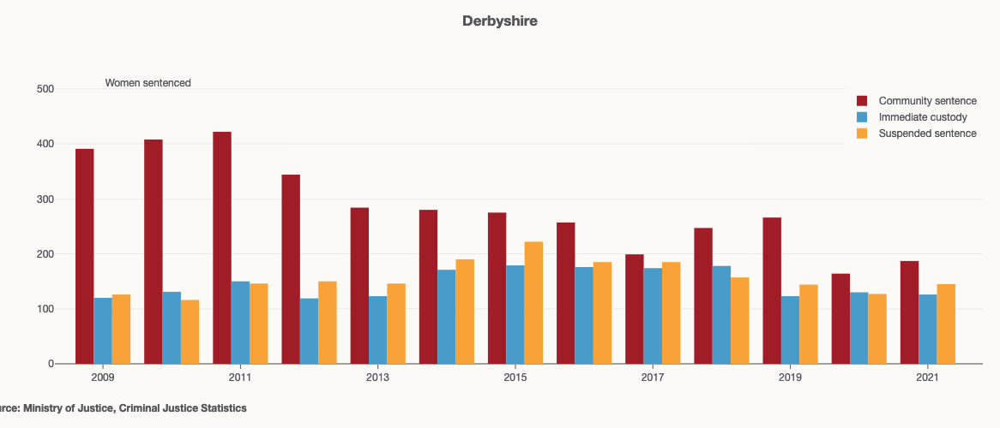

(0, 506.0)


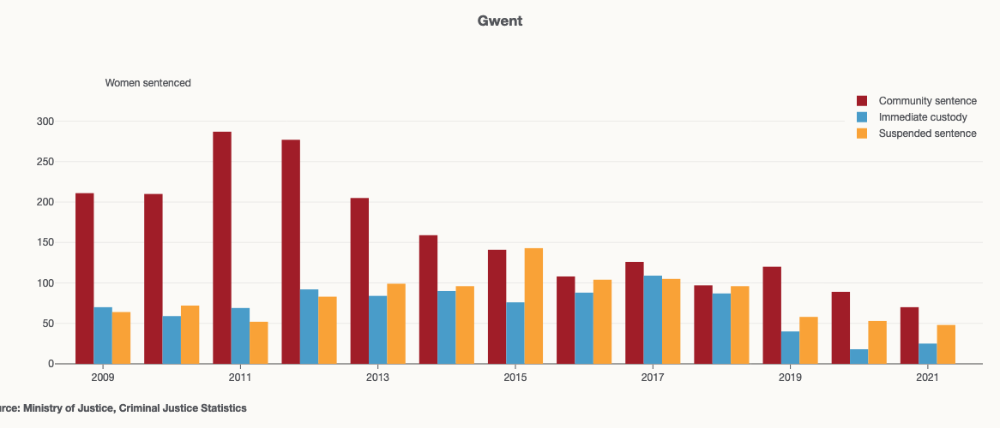

(0, 344.0)


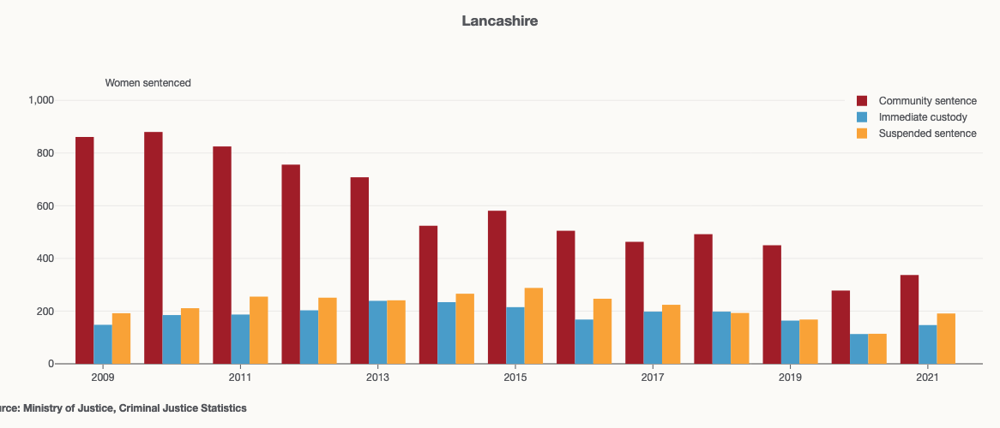

(0, 1056.0)


In [114]:
for pfa in df_filt['pfa'].unique():
    pfa_df = df_filt[df_filt["pfa"] == pfa]
    trace_list = [] # Need to empty my trace_list with every loop through each PFA so that charts are plotted separately
    fig = go.Figure() # Need to also instantiate the figure with every loop in order to clear fig.data values

    for i in pfa_df["outcome"].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
        pfa_df_outcome = pfa_df[pfa_df["outcome"] == i]
        
        
        trace = go.Bar(
            x=pfa_df_outcome["year"],
            y=pfa_df_outcome["freq"],
            name=str(pfa_df_outcome["outcome"].iloc[0]),
            customdata=pfa_df_outcome["outcome"],
            hovertemplate="<b>%{customdata}</b><br>%{y}<extra></extra>",
        )

        trace_list.append(trace)

    fig.add_traces(trace_list)

    ## Chart title
    title = textwrap.wrap(f'<b>{pfa_df_outcome["pfa"].iloc[0]}</b>', width=100)

    fig.update_layout(
        margin=dict(l=64, b=75, r=20),
        barmode="group",
        title="<br>".join(title),
        title_y=0.94,
        title_yanchor="bottom",
        yaxis_title="",
        yaxis_tick0=0,
        yaxis_tickformat=",.0f",
        xaxis_showgrid=False,
        xaxis_tickcolor="#54565B",
        xaxis_dtick=2,
        xaxis_tick0=2009,
        template=prt_template,
        showlegend=True,
        hovermode="x",
        modebar_activecolor="#A01D28",
        width=655,
        height=500,
    )

    fig.update_layout(legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=1
    ))

    ## Chart annotations
    annotations = []

    # Adding source label
    annotations.append(
        dict(
            xref="paper",
            yref="paper",
            x=-0.08,
            y=-0.19,
            align="left",
            yanchor="bottom",
            showarrow=False,
            text="<b>Source: Ministry of Justice, Criminal Justice Statistics</b>",
            font_size=12,
        )
    )

    # Adding y-axis label
    annotations.append(
        dict(
            xref="x",
            yref="paper",
            x=df3_sentence["year"].iloc[0],
            y=1.04,
            align="left",
            xanchor="left",
            showarrow=False,
            text="Women sentenced",
            font_size=12,
        )
    )

    # Adding annotations to layout
    fig.update_layout(annotations=annotations)


    ## Setting chart axis ranges
    max = (fig.data[0].y).max()
    for i in range(len(fig.data)):
        max_trace = (fig.data[i].y).max()
        if max_trace > max:
            max = max_trace
    
    # print(max)
        
    
    fig.update_yaxes(range=[0, (max * 1.2).round(0)])
    fig.update_xaxes(range=[2008.3, 2021.8])

    fig.show(config=config)
    
    print(fig.layout.yaxis.range)

    ## Exporting to static image

    # Save results to ../reports/figures/custody_sentence_lengths, generate if does not exist.
    export_path = Path.joinpath(Path.cwd().parent, "reports", "figures", "cust_comm_sus_sent")
    export_path.mkdir(parents=True, exist_ok=True)

    # Setting filename variable and full path

    filename = str(pfa_df_outcome["pfa"].iloc[0])
    export_svg_path = Path.joinpath(export_path, f'{filename}' + '.svg')

    # fig.write_image(export_svg_path)

#### Now for the full loop

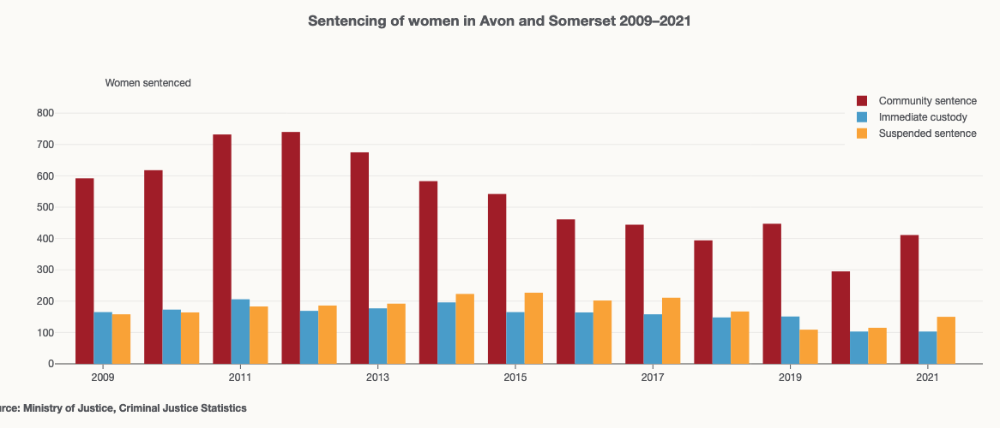

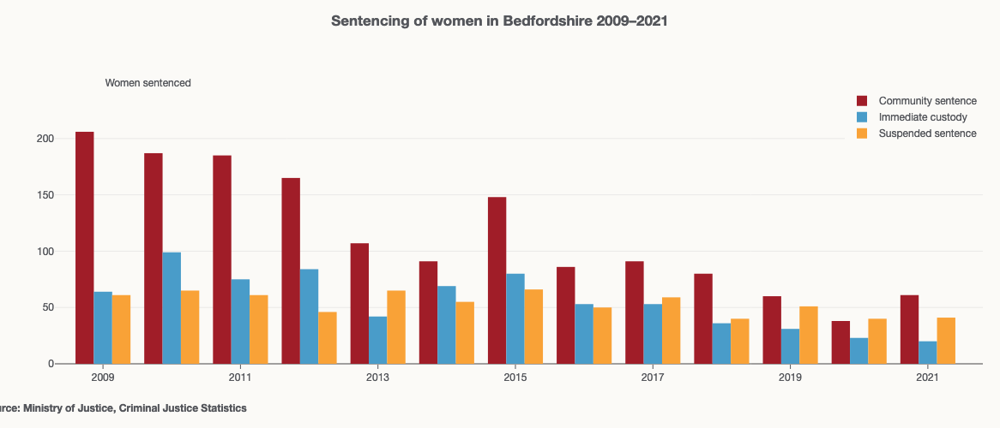

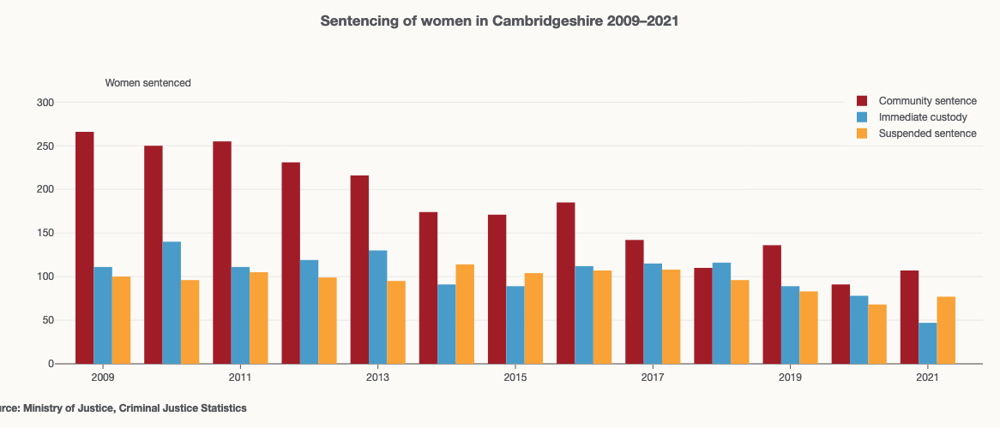

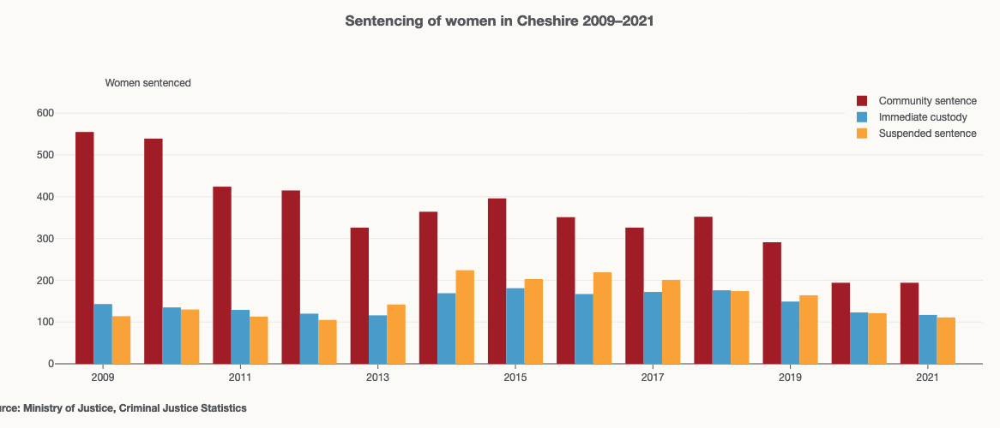

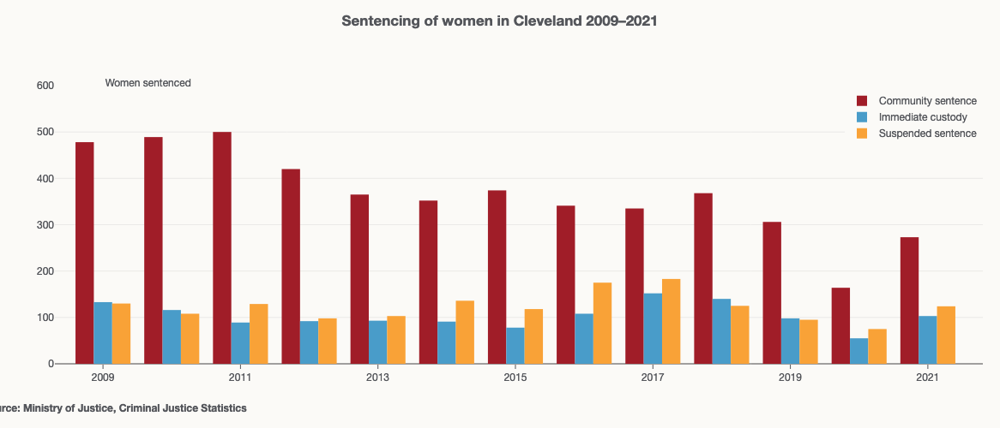

...

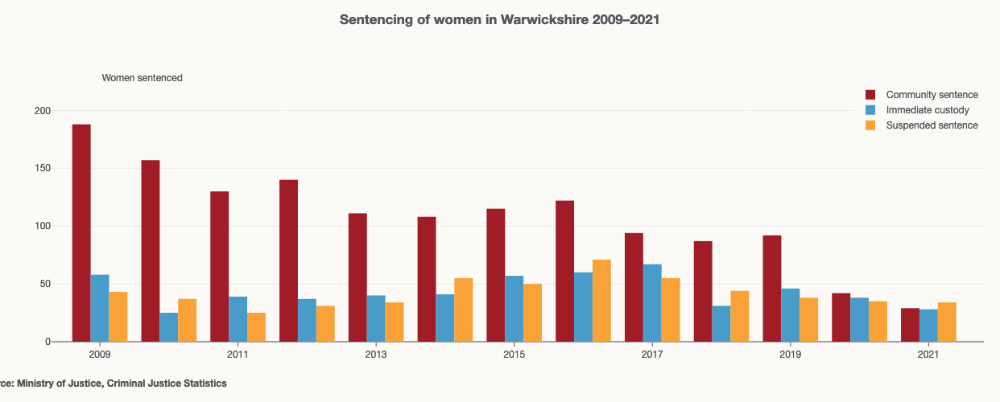

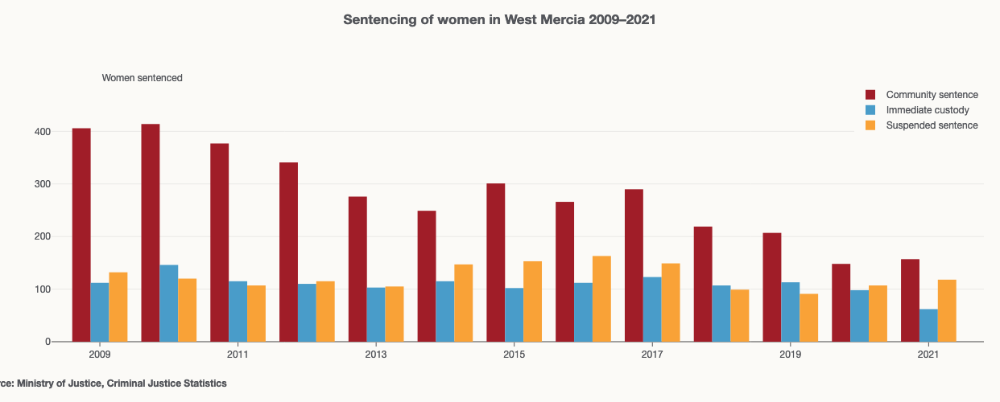

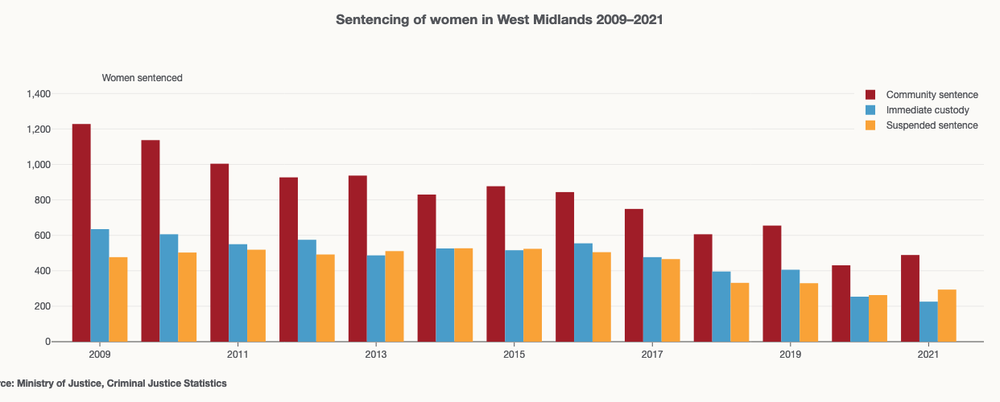

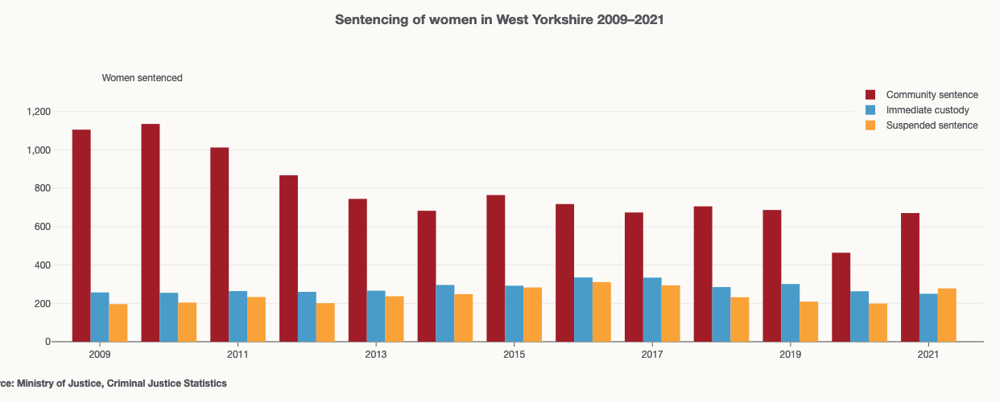

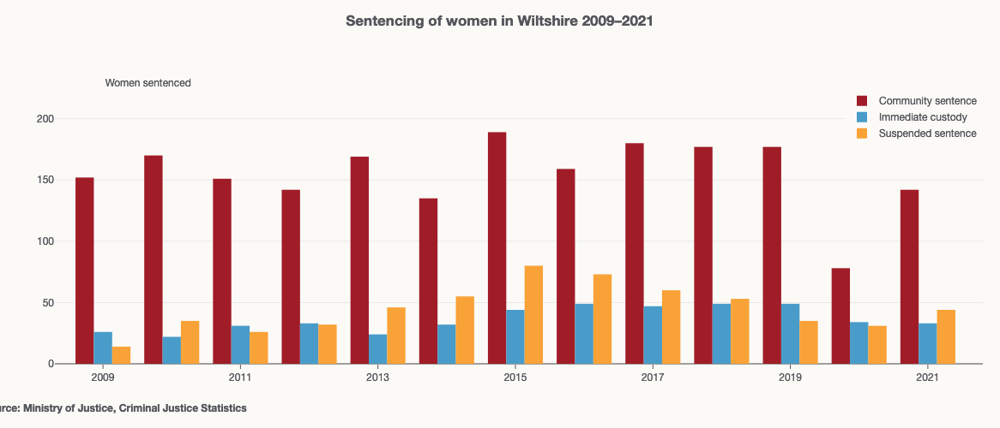

In [117]:
for pfa in df3['pfa'].unique():
    pfa_df = df3[df3["pfa"] == pfa]
    trace_list = [] # Need to empty my trace_list with every loop through each PFA so that charts are plotted separately
    fig = go.Figure() # Need to also instantiate the figure with every loop in order to clear fig.data values

    for i in pfa_df["outcome"].unique():  # Creating a for loop to extract unique values from the dataframe and make traces
        pfa_df_outcome = pfa_df[pfa_df["outcome"] == i]
        
        
        trace = go.Bar(
            x=pfa_df_outcome["year"],
            y=pfa_df_outcome["freq"],
            name=str(pfa_df_outcome["outcome"].iloc[0]),
            customdata=pfa_df_outcome["outcome"].str.lower(),
            hovertemplate="%{y} %{customdata}<extra></extra>",
        )

        trace_list.append(trace)

    fig.add_traces(trace_list)

    ## Chart title
    title = textwrap.wrap(f'<b>Sentencing of women in {pfa_df_outcome["pfa"].iloc[0]} 2009–2021</b>', width=60)

    fig.update_layout(
        margin=dict(l=64, b=75, r=20),
        barmode="group",
        title="<br>".join(title),
        title_y=0.94,
        title_yanchor="bottom",
        yaxis_title="",
        yaxis_tick0=0,
        yaxis_tickformat=",.0f",
        xaxis_showgrid=False,
        xaxis_tickcolor="#54565B",
        xaxis_dtick=2,
        xaxis_tick0=2009,
        template=prt_template,
        showlegend=True,
        hovermode="x",
        modebar_activecolor="#A01D28",
        width=655,
        height=500,
    )

    fig.update_layout(legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=1
    ))

    ## Chart annotations
    annotations = []

    # Adding source label
    annotations.append(
        dict(
            xref="paper",
            yref="paper",
            x=-0.08,
            y=-0.19,
            align="left",
            yanchor="bottom",
            showarrow=False,
            text="<b>Source: Ministry of Justice, Criminal Justice Statistics</b>",
            font_size=12,
        )
    )

    # Adding y-axis label
    annotations.append(
        dict(
            xref="x",
            yref="paper",
            x=df3_sentence["year"].iloc[0],
            y=1.04,
            align="left",
            xanchor="left",
            showarrow=False,
            text="Women sentenced",
            font_size=12,
        )
    )

    # Adding annotations to layout
    fig.update_layout(annotations=annotations)


    ## Setting chart axis ranges
    max = (fig.data[0].y).max()
    for i in range(len(fig.data)):
        max_trace = (fig.data[i].y).max()
        if max_trace > max:
            max = max_trace
        
    
    fig.update_yaxes(range=[0, (max * 1.2).round(0)])
    fig.update_xaxes(range=[2008.3, 2021.8])

    fig.show(config=config)

    ## Exporting to static image

    # Save results to ../reports/figures/cust_comm_sus_sent, generate if does not exist.
    export_path = Path.joinpath(Path.cwd().parent, "reports", "figures", "cust_comm_sus_sent")
    export_path.mkdir(parents=True, exist_ok=True)

    # Setting filename variable and full path

    filename = str(pfa_df_outcome["pfa"].iloc[0])
    export_svg_path = Path.joinpath(export_path, f'{filename}' + '.svg')

    fig.write_image(export_svg_path)